# Setup env

In [11]:
import os
import cv2
import glob
import PIL
import shutil
import numpy as np

In [12]:
pip install git+https://github.com/miykael/gif_your_nifti.git

  Cloning https://github.com/miykael/gif_your_nifti.git to c:\users\basur\appdata\local\temp\pip-req-build-8swwagjp
  Resolved https://github.com/miykael/gif_your_nifti.git to commit 55c09c42921f4871cf43f63a303ab420a92a4f03
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
Note: you may need to restart the kernel to use updated packages.


  Running command git clone --filter=blob:none --quiet https://github.com/miykael/gif_your_nifti.git 'C:\Users\basur\AppData\Local\Temp\pip-req-build-8swwagjp'


In [13]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from skimage import data
from skimage.util import montage 
import skimage.transform as skTrans
from skimage.transform import rotate
from skimage.transform import resize
from PIL import Image, ImageOps  


# neural imaging
import nilearn as nl
import nibabel as nib
import nilearn.plotting as nlplt

import gif_your_nifti.core as gif2nif


# ml libs
import keras
import keras.backend as K
from keras.callbacks import CSVLogger
import tensorflow as tf
from tensorflow.keras.utils import plot_model
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, TensorBoard
# Correct import for preprocessing layers
from tensorflow.keras.layers import Rescaling, Normalization




# Make numpy printouts easier to read.
np.set_printoptions(precision=3, suppress=True)

In [14]:
!pip install kagglehub

In [15]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("awsaf49/brats20-dataset-training-validation")

print("Path to dataset files:", path)

Path to dataset files: C:\Users\basur\.cache\kagglehub\datasets\awsaf49\brats20-dataset-training-validation\versions\1


In [16]:
# Download latest version
path = kagglehub.dataset_download("rastislav/model-x80-dcs65")

print("Path to dataset files:", path)

Path to dataset files: C:\Users\basur\.cache\kagglehub\datasets\rastislav\model-x80-dcs65\versions\1


In [17]:
# Download latest version
path = kagglehub.dataset_download("rastislav/modelperclasseval")

print("Path to dataset files:", path)

Path to dataset files: C:\Users\basur\.cache\kagglehub\datasets\rastislav\modelperclasseval\versions\1


# Image data descriptions

All BraTS multimodal scans are available as  NIfTI files (.nii.gz) -> commonly used medical imaging format to store brain imagin data obtained using MRI and describe different MRI settings 
1. **T1**: T1-weighted, native image, sagittal or axial 2D acquisitions, with 1–6 mm slice thickness.
2. **T1c**: T1-weighted, contrast-enhanced (Gadolinium) image, with 3D acquisition and 1 mm isotropic voxel size for most patients.
3. **T2**: T2-weighted image, axial 2D acquisition, with 2–6 mm slice thickness.
4. **FLAIR**: T2-weighted FLAIR image, axial, coronal, or sagittal 2D acquisitions, 2–6 mm slice thickness.

Data were acquired with different clinical protocols and various scanners from multiple (n=19) institutions.

All the imaging datasets have been segmented manually, by one to four raters, following the same annotation protocol, and their annotations were approved by experienced neuro-radiologists. Annotations comprise the GD-enhancing tumor (ET — label 4), the peritumoral edema (ED — label 2), and the necrotic and non-enhancing tumor core (NCR/NET — label 1), as described both in the BraTS 2012-2013 TMI paper and in the latest BraTS summarizing paper. The provided data are distributed after their pre-processing, i.e., co-registered to the same anatomical template, interpolated to the same resolution (1 mm^3) and skull-stripped.



In [18]:
%pip install synapseclient
%pip install synapseutils 

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement synapseutils (from versions: none)
ERROR: No matching distribution found for synapseutils


Text(0.5, 1.0, 'Mask')

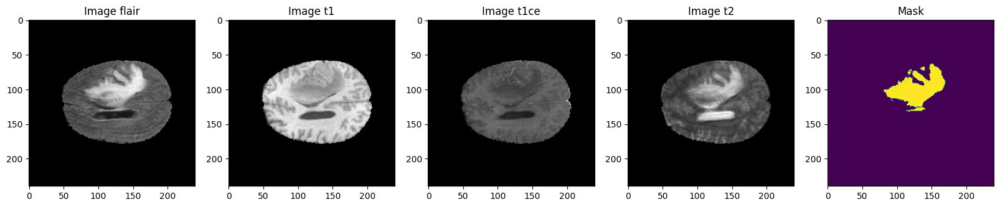

In [19]:
TRAINPATH = r"C:\Users\basur\.cache\kagglehub\datasets\awsaf49\brats20-dataset-training-validation\versions\1\BraTS2020_TrainingData\MICCAI_BraTS2020_TrainingData"
VALIDATIONPATH = r"C:\Users\basur\.cache\kagglehub\datasets\awsaf49\brats20-dataset-training-validation\versions\1\BraTS2020_ValidationData\MICCAI_BraTS2020_ValidationData"

test_image_flair = nib.load(TRAINPATH + r"\BraTS20_Training_001\BraTS20_Training_001_flair.nii").get_fdata()
test_image_t1 = nib.load(TRAINPATH + r"\BraTS20_Training_001\BraTS20_Training_001_t1.nii").get_fdata()
test_image_t1ce = nib.load(TRAINPATH + r"\BraTS20_Training_001\BraTS20_Training_001_t1ce.nii").get_fdata()
test_image_t2 = nib.load(TRAINPATH + r"\BraTS20_Training_001\BraTS20_Training_001_t2.nii").get_fdata()
test_mask = nib.load(TRAINPATH + r"\BraTS20_Training_001\BraTS20_Training_001_seg.nii").get_fdata()


fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize = (20, 10))
slice_w = 25
ax1.imshow(test_image_flair[:,:,test_image_flair.shape[0]//2-slice_w], cmap = 'gray')
ax1.set_title('Image flair')
ax2.imshow(test_image_t1[:,:,test_image_t1.shape[0]//2-slice_w], cmap = 'gray')
ax2.set_title('Image t1')
ax3.imshow(test_image_t1ce[:,:,test_image_t1ce.shape[0]//2-slice_w], cmap = 'gray')
ax3.set_title('Image t1ce')
ax4.imshow(test_image_t2[:,:,test_image_t2.shape[0]//2-slice_w], cmap = 'gray')
ax4.set_title('Image t2')
ax5.imshow(test_mask[:,:,test_mask.shape[0]//2-slice_w])
ax5.set_title('Mask')

**Show whole nifti data -> print each slice from 3d data**

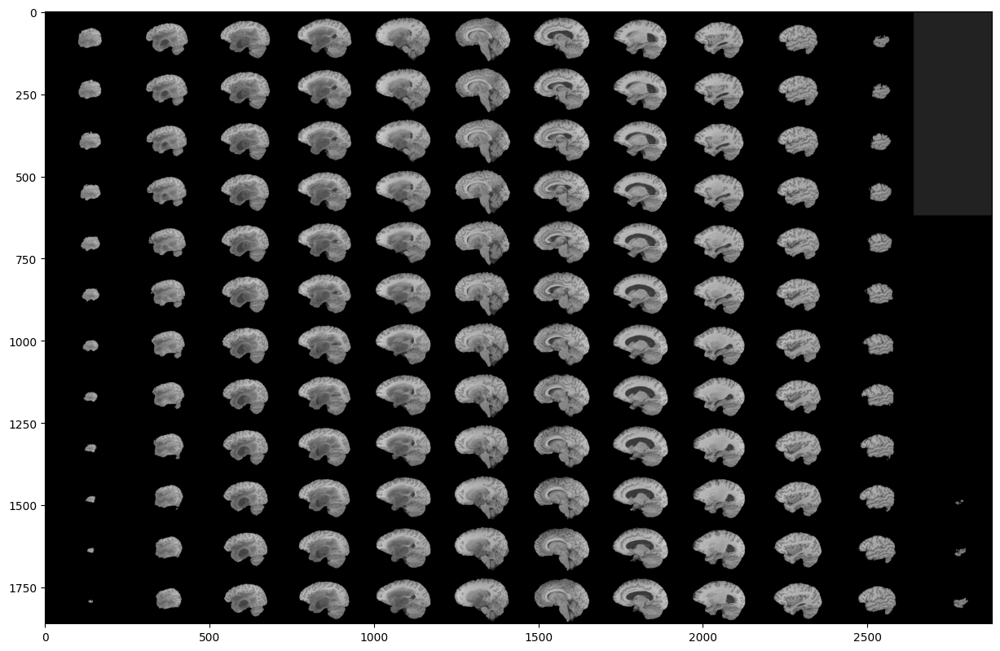

In [20]:
# Skip 50:-50 slices since there is not much to see
fig, ax1 = plt.subplots(1, 1, figsize = (15,15))
ax1.imshow(rotate(montage(test_image_t1[50:-50,:,:]), 90, resize=True), cmap ='gray')

**Show segment of tumor for each above slice**

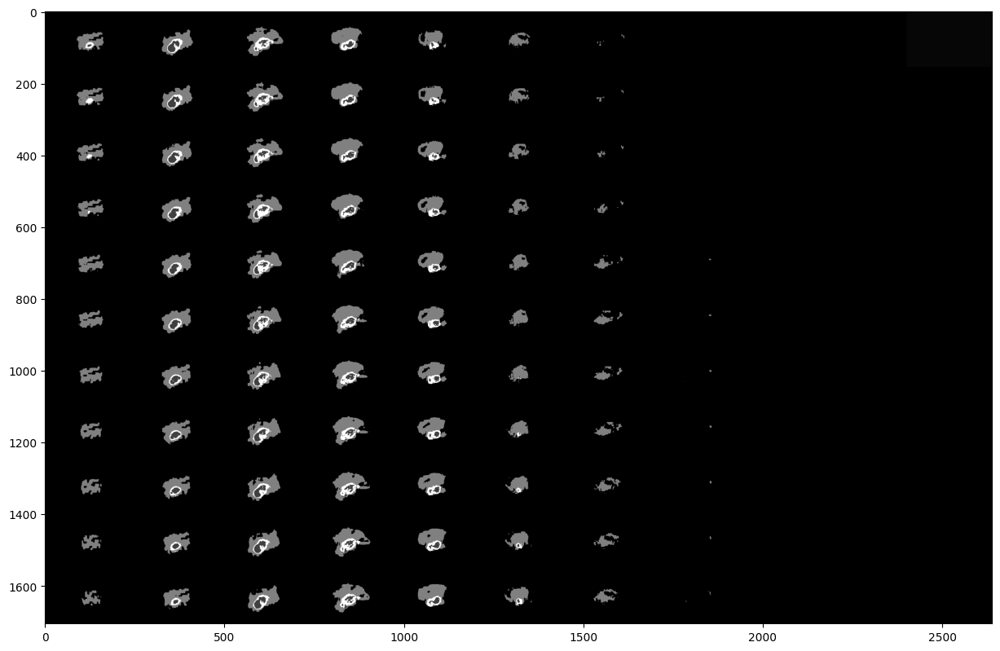

In [21]:
# Skip 50:-50 slices since there is not much to see
fig, ax1 = plt.subplots(1, 1, figsize = (15,15))
ax1.imshow(rotate(montage(test_mask[60:-60,:,:]), 90, resize=True), cmap ='gray')

In [22]:
shutil.copy2(TRAINPATH + r'\BraTS20_Training_001\BraTS20_Training_001_flair.nii', './test_gif_BraTS20_Training_001_flair.nii')
gif2nif.write_gif_normal('./test_gif_BraTS20_Training_001_flair.nii')

**Gif representation of slices in 3D volume**


<img src="https://media1.tenor.com/images/15427ffc1399afc3334f12fd27549a95/tenor.gif?itemid=20554734">

**Show segments of tumor using different effects**

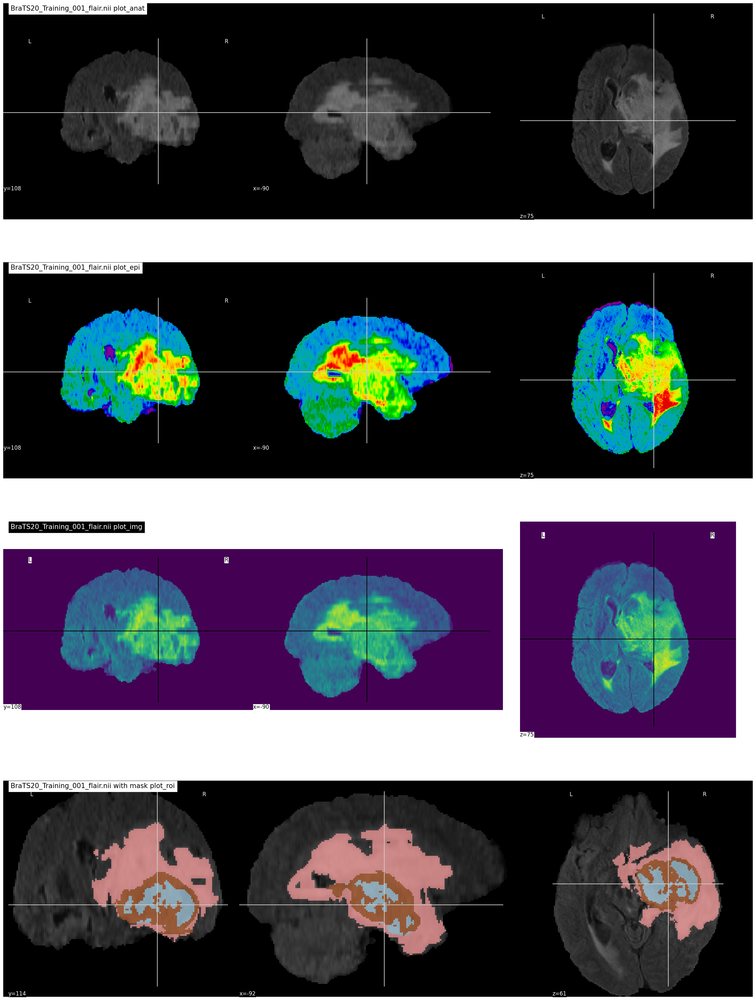

In [23]:
niimg = nl.image.load_img(TRAINPATH + r'\BraTS20_Training_001\BraTS20_Training_001_flair.nii')
nimask = nl.image.load_img(TRAINPATH + r'\BraTS20_Training_001\BraTS20_Training_001_seg.nii')

fig, axes = plt.subplots(nrows=4, figsize=(30, 40))

nlplt.plot_anat(niimg,
                title='BraTS20_Training_001_flair.nii plot_anat',
                axes=axes[0])

nlplt.plot_epi(niimg,
               title='BraTS20_Training_001_flair.nii plot_epi',
               axes=axes[1])

nlplt.plot_img(niimg,
               title='BraTS20_Training_001_flair.nii plot_img',
               axes=axes[2])

nlplt.plot_roi(nimask, 
               title='BraTS20_Training_001_flair.nii with mask plot_roi',
               bg_img=niimg, 
               axes=axes[3], cmap='Paired')

plt.show()

# Create model Segnet



In [24]:
%pip install keras

import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#%matplotlib inline
import tensorflow as tf
from tensorflow.keras import backend as K
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import metrics
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Input, BatchNormalization, Activation, Dense, Dropout, Maximum
from tensorflow.keras.layers import Lambda, RepeatVector, Reshape
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Conv3D, Conv3DTranspose
from tensorflow.keras.layers import MaxPooling2D, GlobalMaxPool2D, MaxPooling3D
# from tensorflow.keras.layers import concatenate, add
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.optimizers import Adam
# from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img

from skimage.io import imread, imshow, concatenate_images
from skimage.transform import resize
from sklearn.utils import class_weight


from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import CSVLogger
from tensorflow.keras.callbacks import EarlyStopping

import os
from skimage.io import imread, imshow, concatenate_images
from skimage.transform import resize
# from medpy.io import load
import numpy as np

#import cv2
import nibabel as nib
from PIL import Image


Note: you may need to restart the kernel to use updated packages.


Note: you may need to restart the kernel to use updated packages.
  Using cached protobuf-4.25.5-cp310-abi3-win_amd64.whl.metadata (541 bytes)
Using cached protobuf-4.25.5-cp310-abi3-win_amd64.whl (413 kB)
  Attempting uninstall: protobuf
    Found existing installation: protobuf 5.29.3
    Uninstalling protobuf-5.29.3:
      Successfully uninstalled protobuf-5.29.3
Note: you may need to restart the kernel to use updated packages.


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
opentelemetry-proto 1.29.0 requires protobuf<6.0,>=5.0, but you have protobuf 4.25.5 which is incompatible.


Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


[WARNING] c:\Users\basur\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\optimizers\base_optimizer.py:86: UserWarning: Argument `decay` is no longer supported and will be ignored.
  warnings.warn(



!!!!!!!!!!!!!!!!!!!
(None, 128, 128, 128, 4)


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 128, 4)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d (Conv3D)     │ (None, 128, 128,  │        872 │ input_layer[0][0] │
│                     │ 128, 8)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 128, 128,  │         32 │ conv3d[0][0]      │
│ (BatchNormalizatio… │ 128, 8)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 128, 128,  │          0 │ batch_normalizat… │
│ (Activation)        │ 128, 8)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_1 (Conv3D)   │ (None, 128, 128,  │      1,736 │ activation[0][0]  │
│                     │ 128, 8)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │         32 │ conv3d_1[0][0]    │
│ (BatchNormalizatio… │ 128, 8)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, 128, 128,  │          0 │ batch_normalizat… │
│ (Activation)        │ 128, 8)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling3d       │ (None, 64, 64,    │          0 │ activation_1[0][… │
│ (MaxPooling3D)      │ 64, 8)            │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 64, 64,    │          0 │ max_pooling3d[0]… │
│                     │ 64, 8)            │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_2 (Conv3D)   │ (None, 64, 64,    │      3,472 │ dropout[0][0]     │
│                     │ 64, 16)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │         64 │ conv3d_2[0][0]    │
│ (BatchNormalizatio… │ 64, 16)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (Activation)        │ 64, 16)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_3 (Conv3D)   │ (None, 64, 64,    │      6,928 │ activation_2[0][… │
│                     │ 64, 16)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │         64 │ conv3d_3[0][0]    │
│ (BatchNormalizatio… │ 64, 16)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (Activation)        │ 64, 16)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling3d_1     │ (None, 32, 32,    │          0 │ activation_3[0][… │
│ (MaxPooling3D)      │ 32, 16)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 32, 32,    │          0 │ max_pooling3d_1[

 Total params: 1,622,108 (6.19 MB)

 Trainable params: 1,620,636 (6.18 MB)

 Non-trainable params: 1,472 (5.75 KB)

BraTS20_Training_001
Entered modality
Entered ground truth
Entered modality
Entered modality
(240, 240, 155, 4)
(240, 240, 155)
x


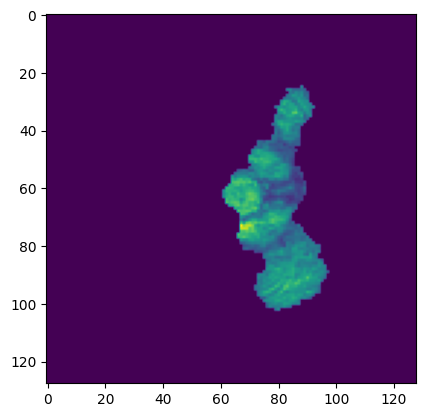

y


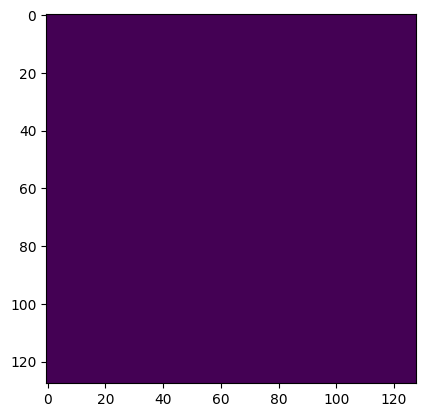

new
x


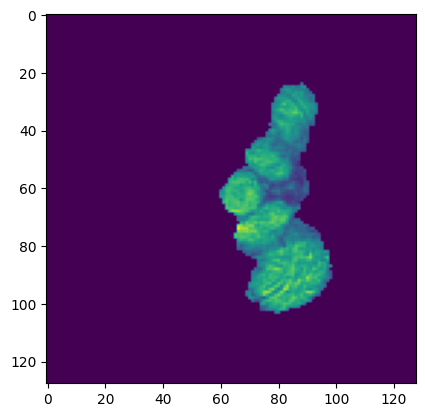

y


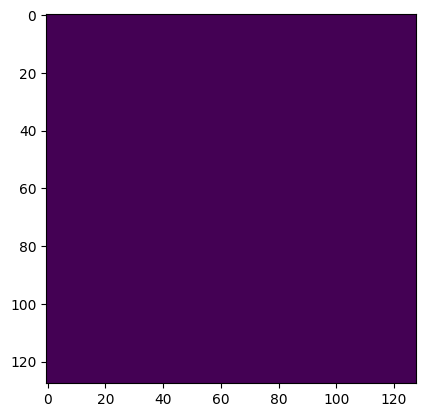

new
x


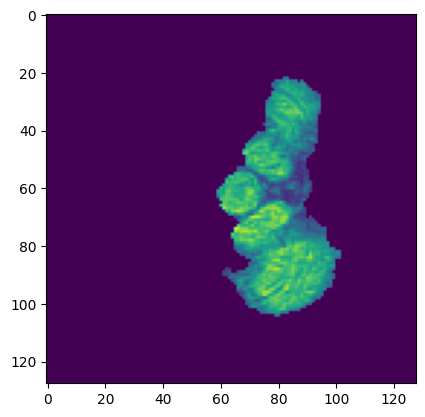

y


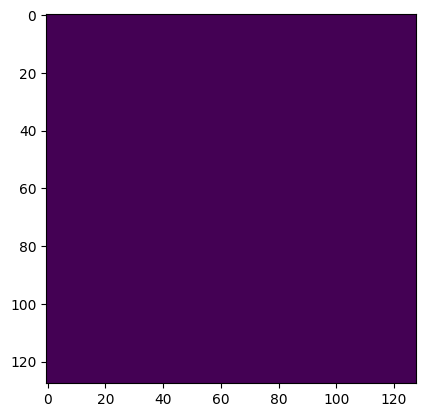

new
x


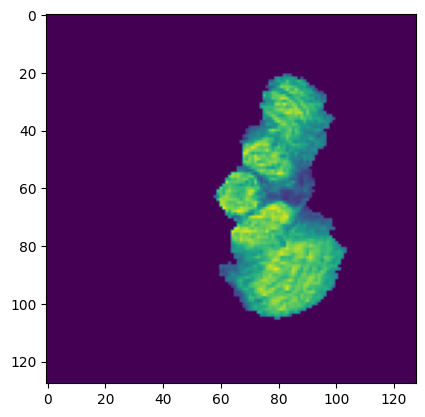

y


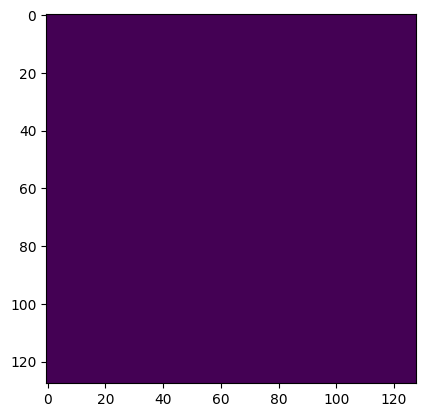

new
x


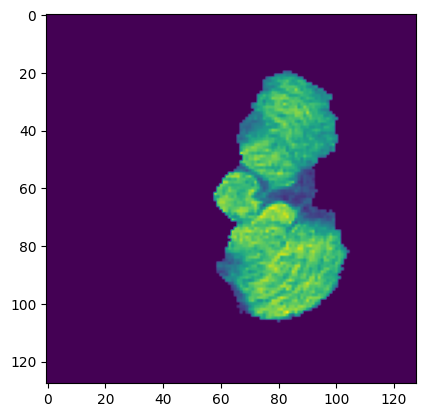

y


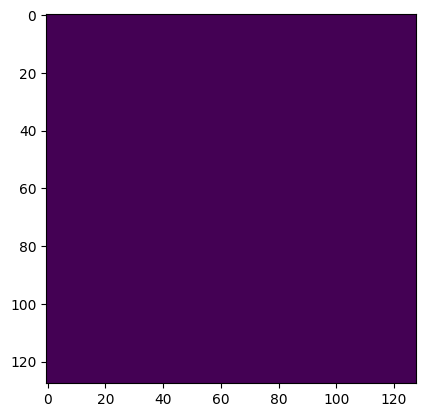

new
x


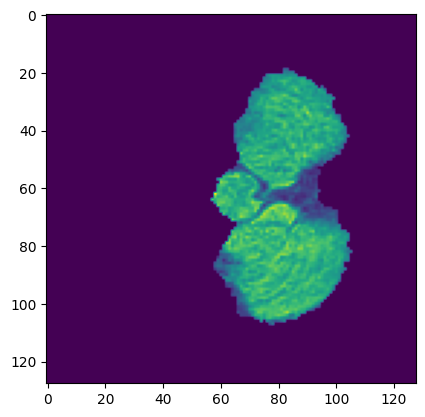

y


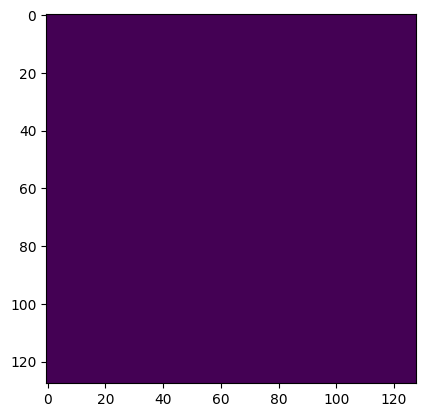

new
x


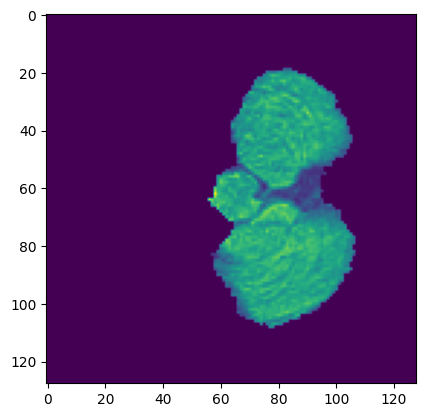

y


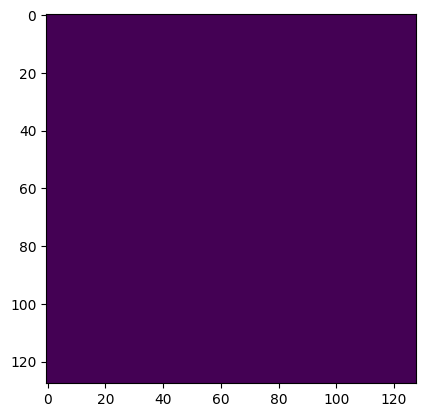

new
x


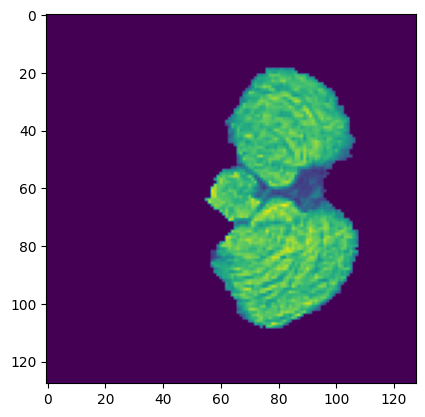

y


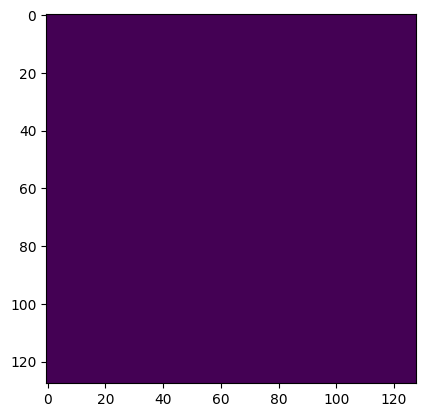

new
x


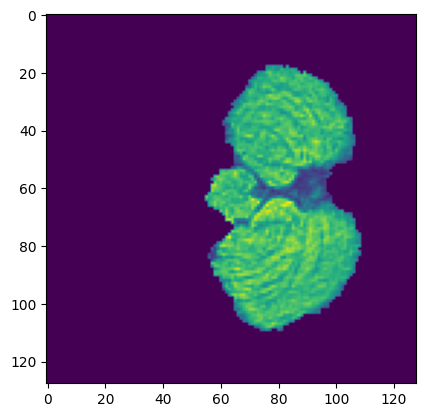

y


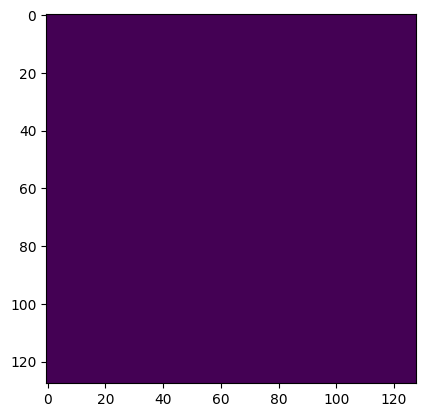

new
x


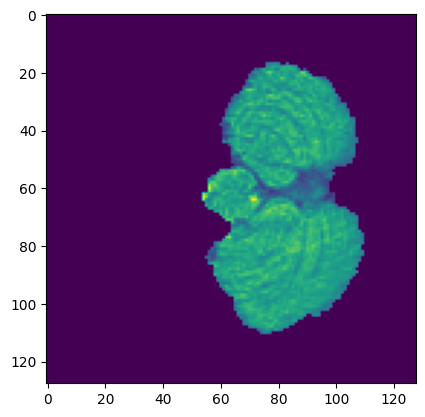

y


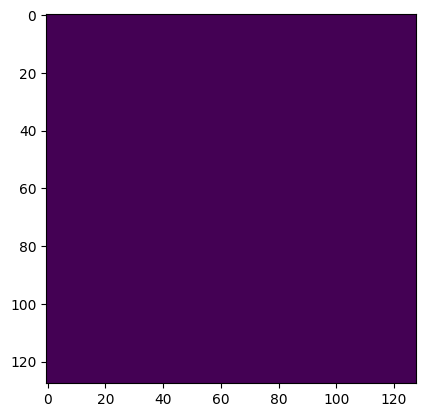

new
x


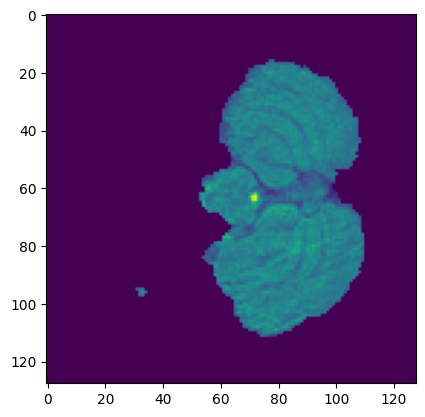

y


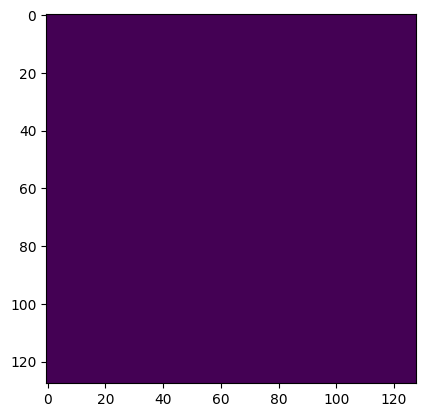

new
x


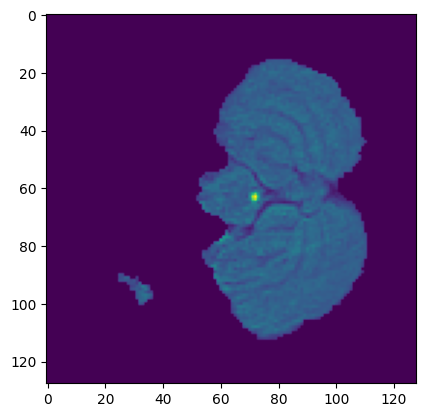

y


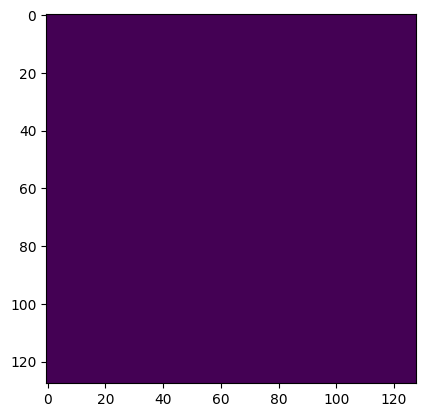

new
x


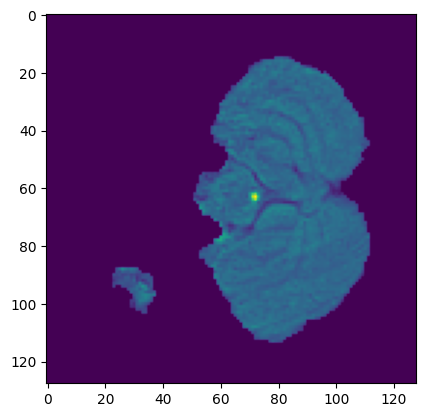

y


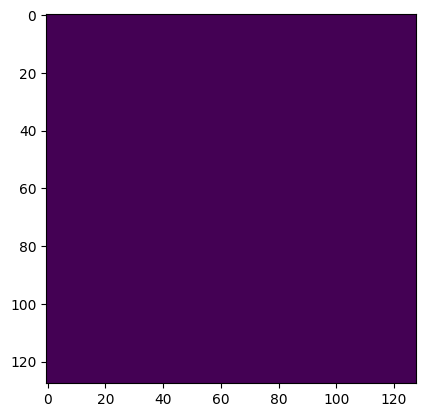

new
x


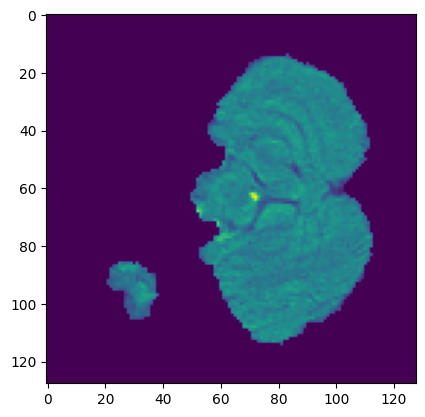

y


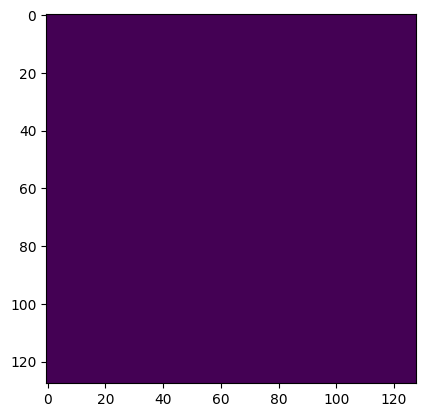

new
x


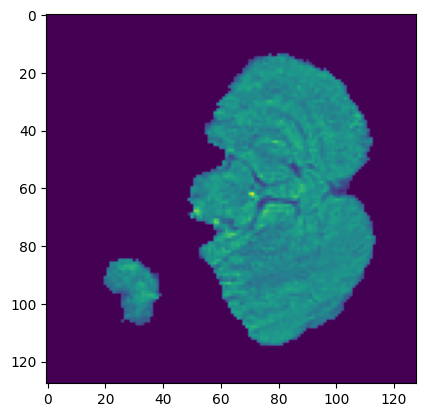

y


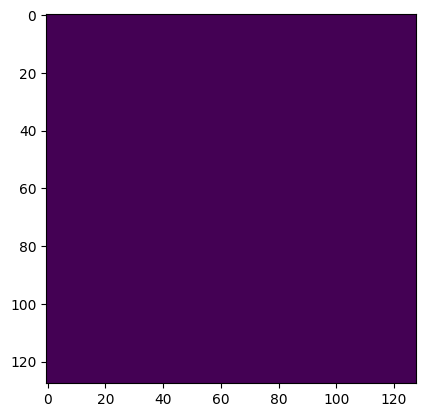

new
x


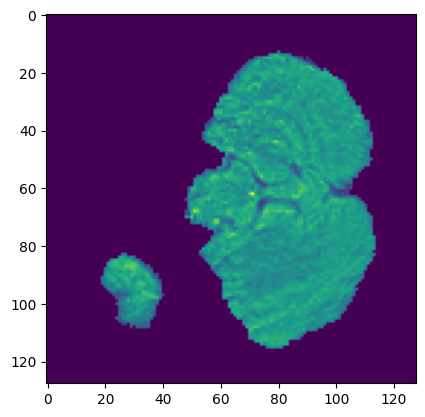

y


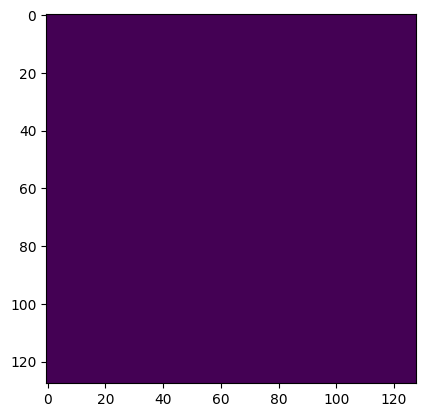

new
x


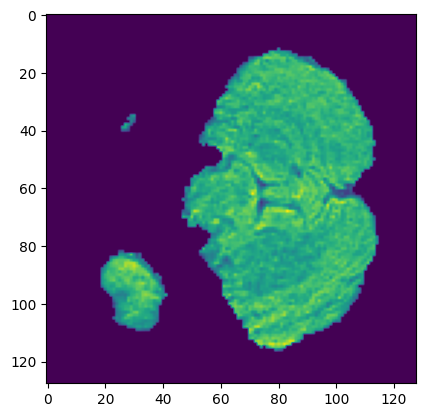

y


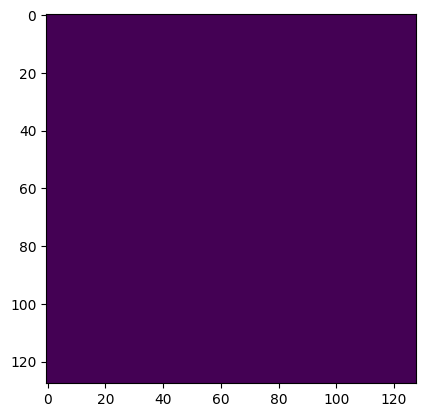

new
x


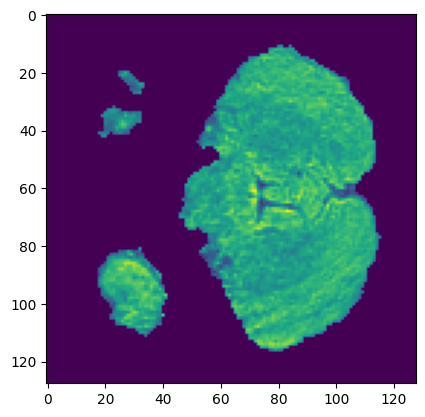

y


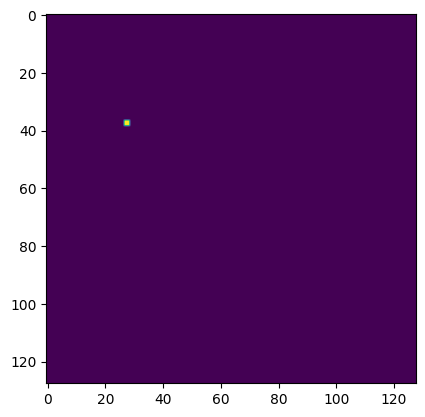

new
x


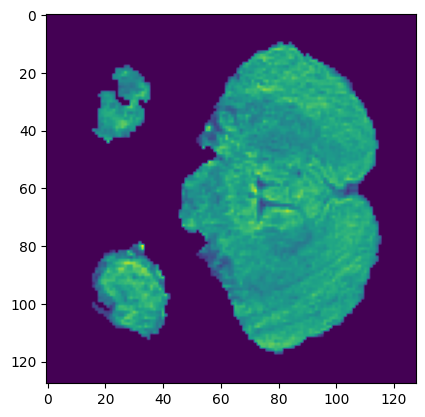

y


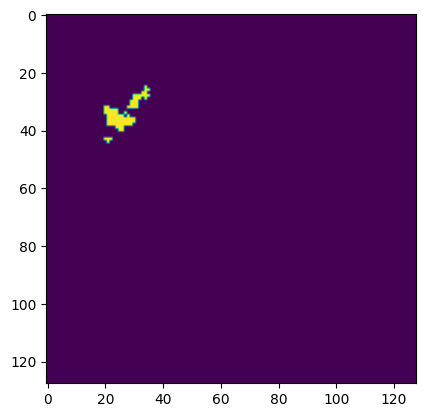

new
x


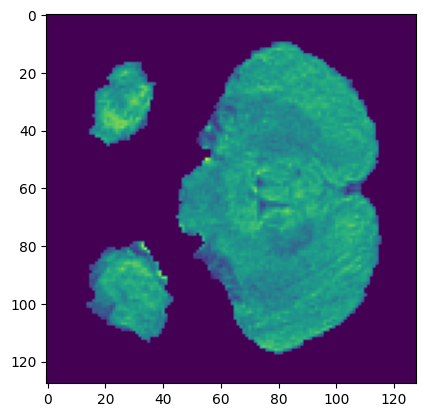

y


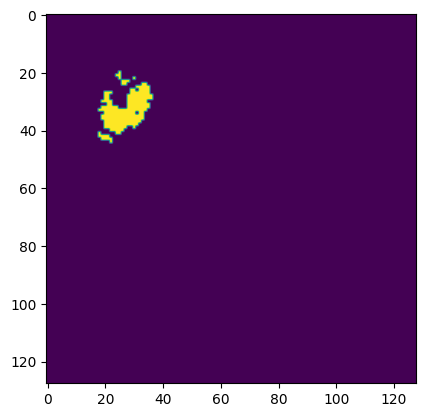

new
x


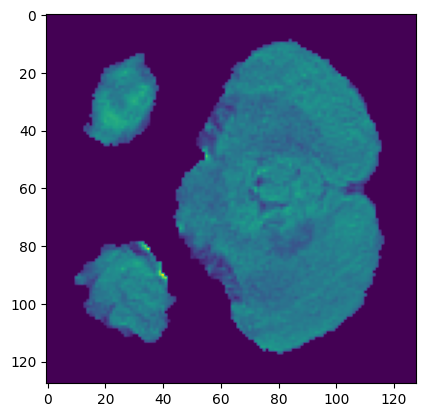

y


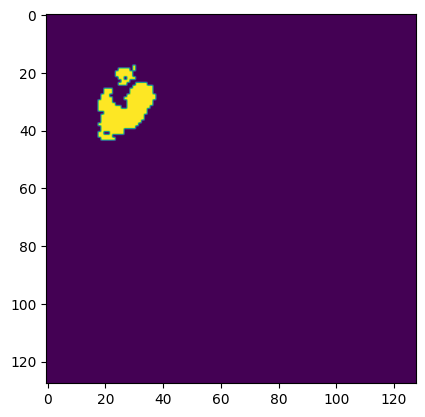

new
x


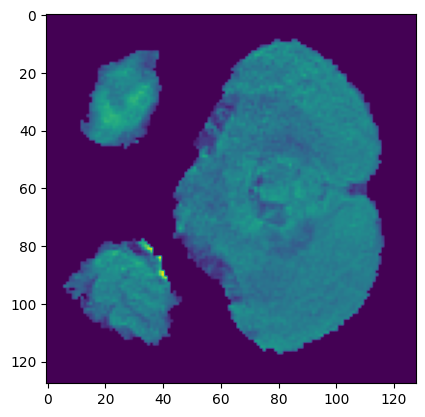

y


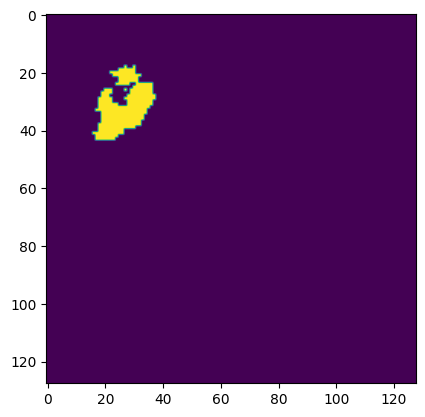

new
x


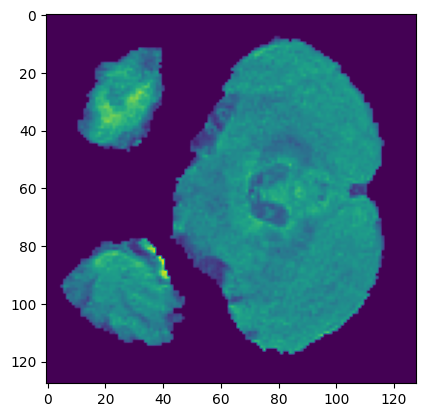

y


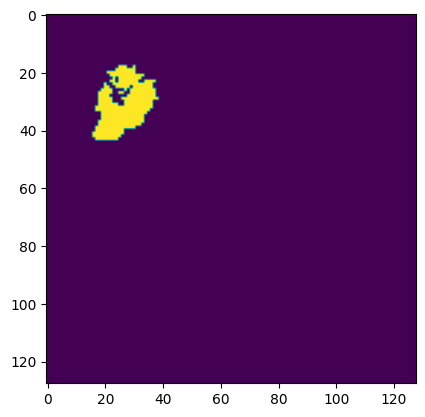

new
x


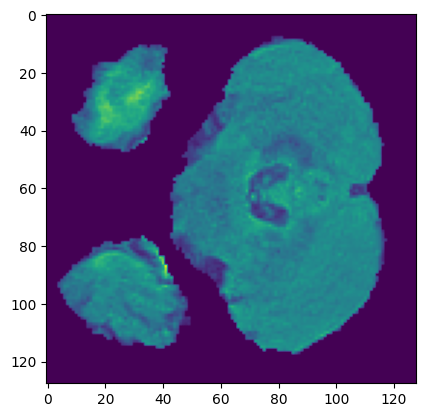

y


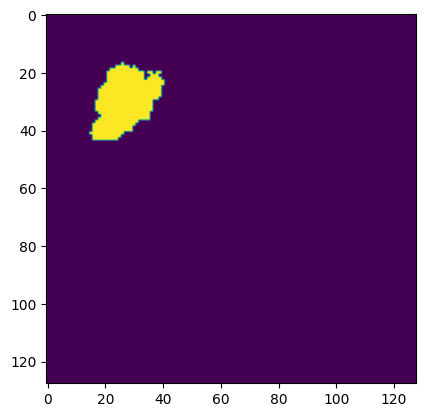

new
x


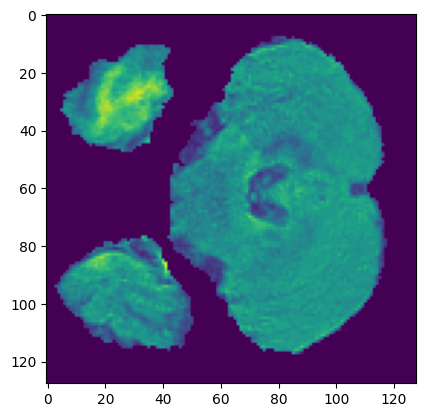

y


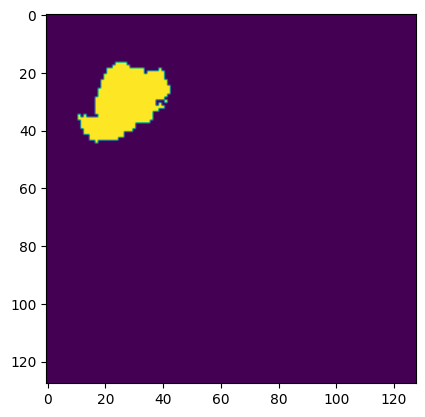

new
x


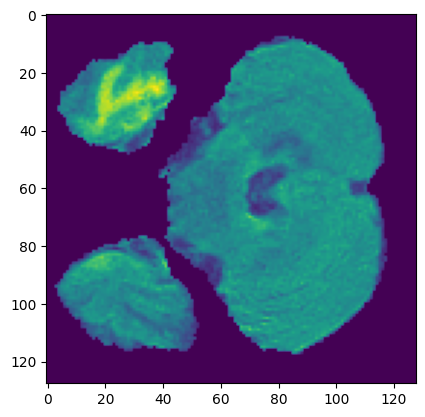

y


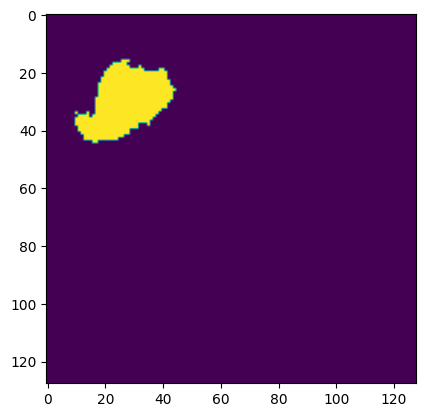

new
x


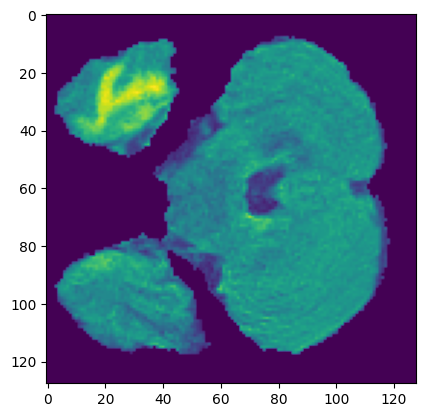

y


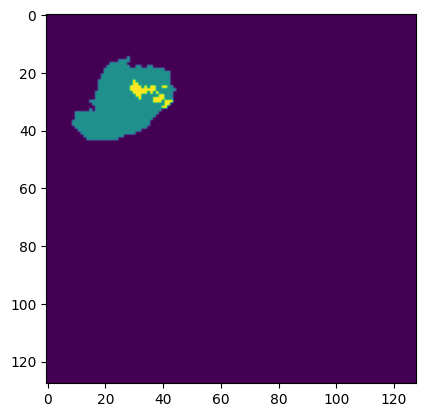

new
x


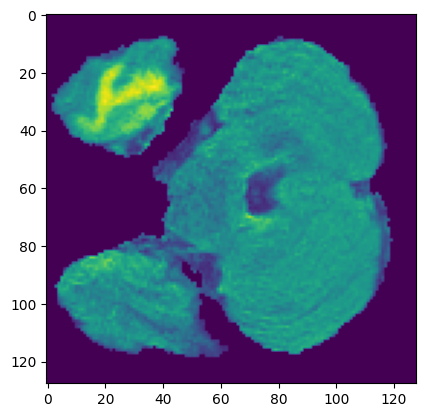

y


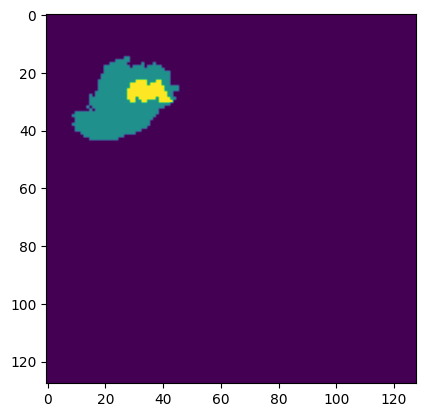

new
x


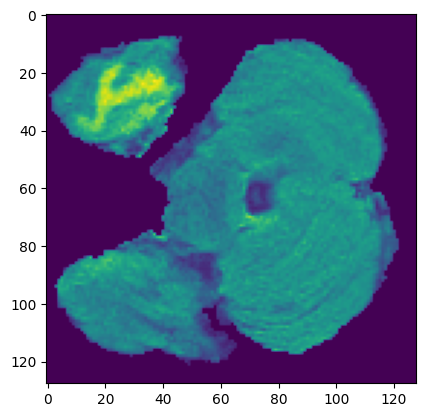

y


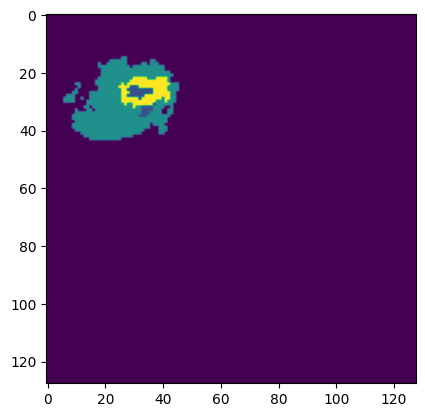

new
x


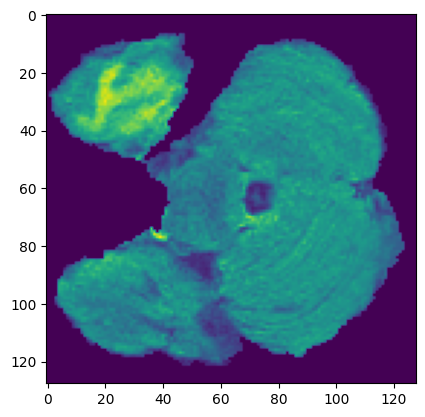

y


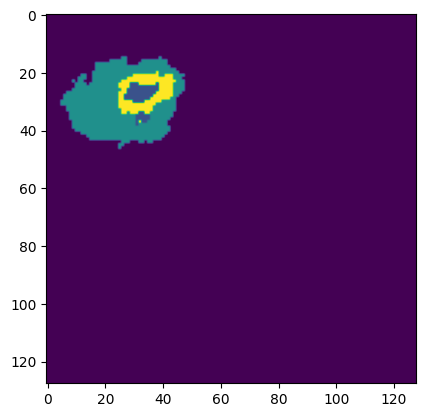

new
x


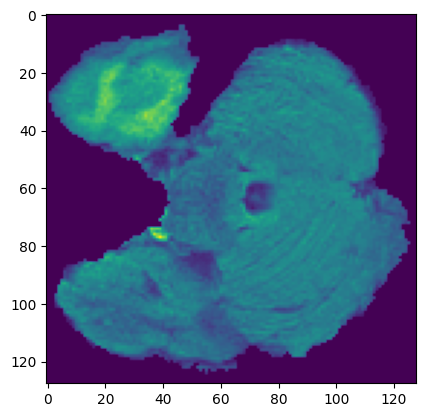

y


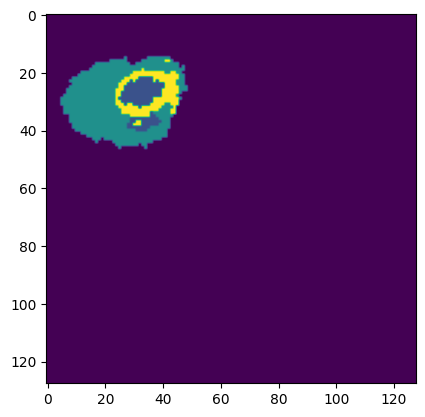

new
x


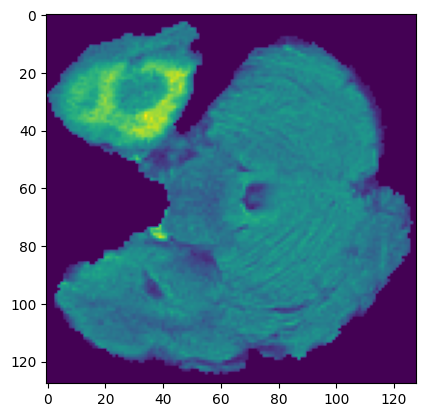

y


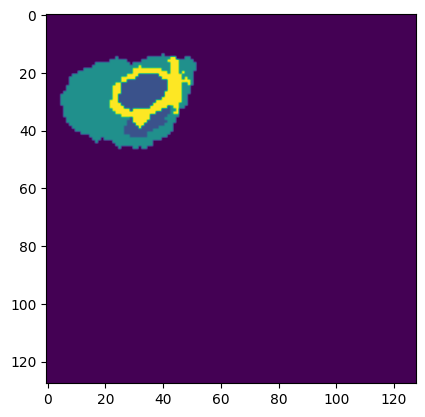

new
x


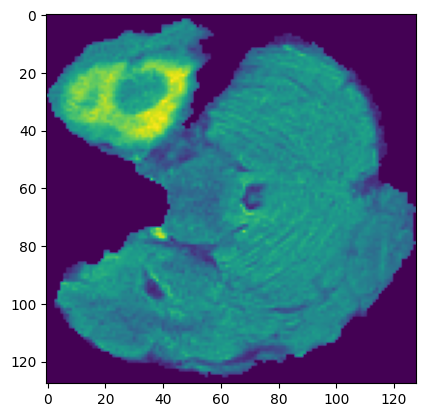

y


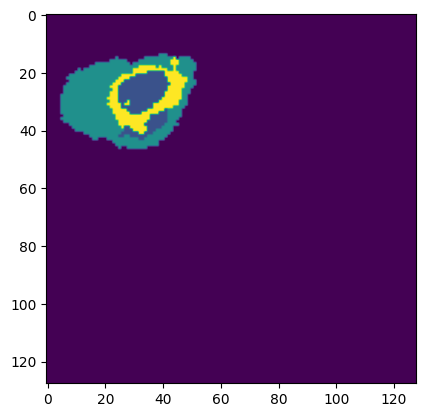

new
x


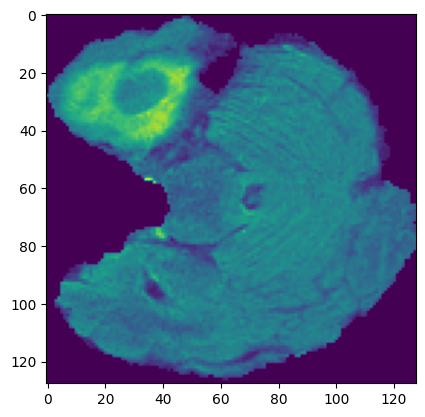

y


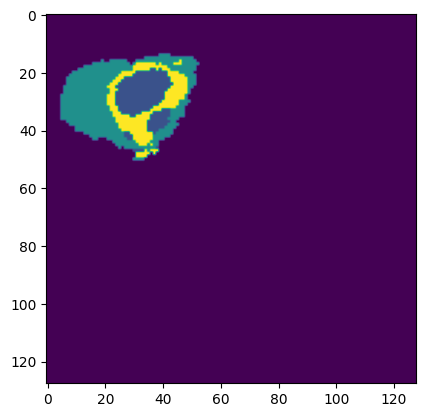

new
x


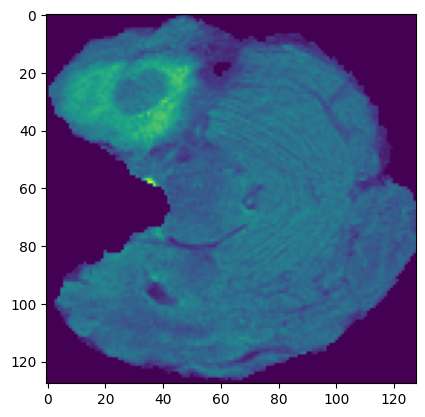

y


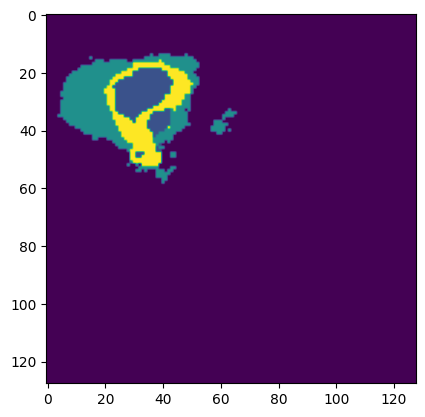

new
x


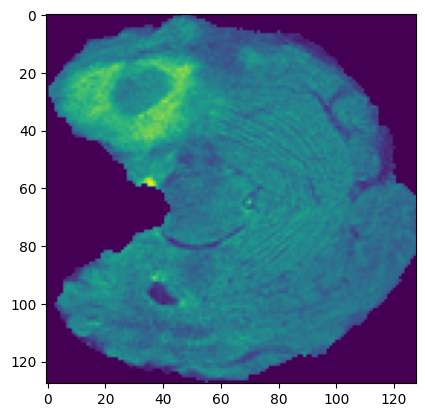

y


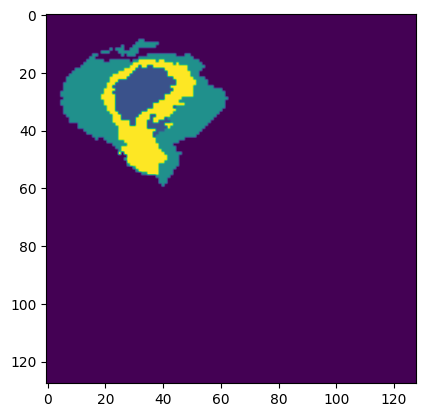

new
x


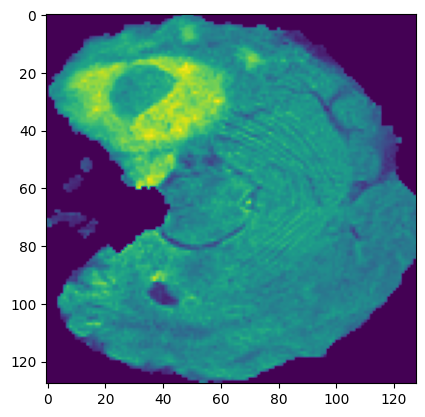

y


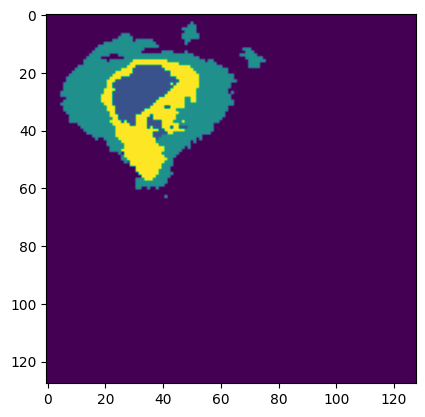

new
x


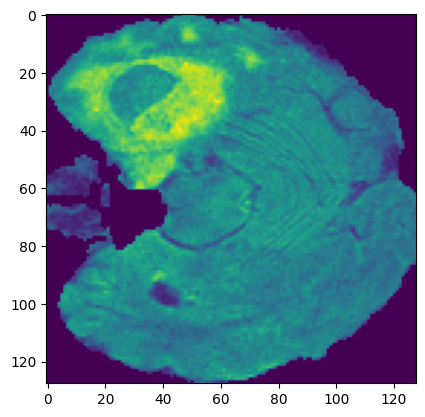

y


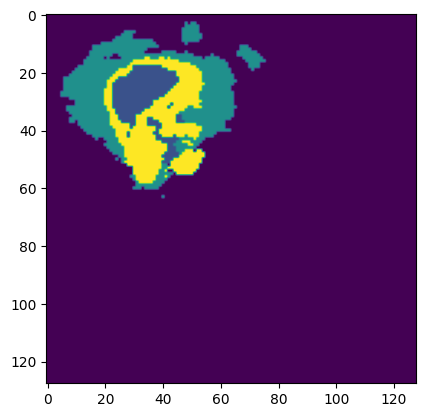

new
x


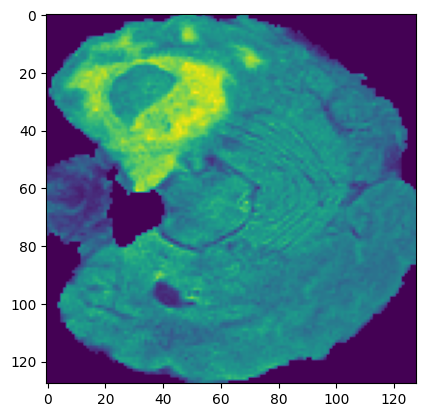

y


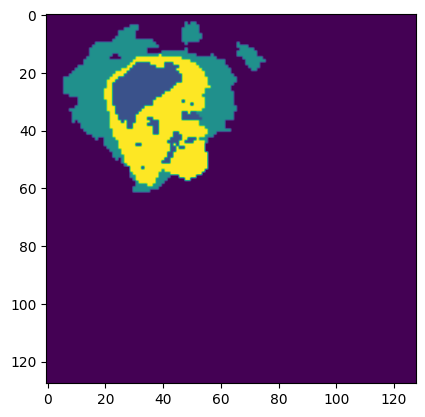

new
x


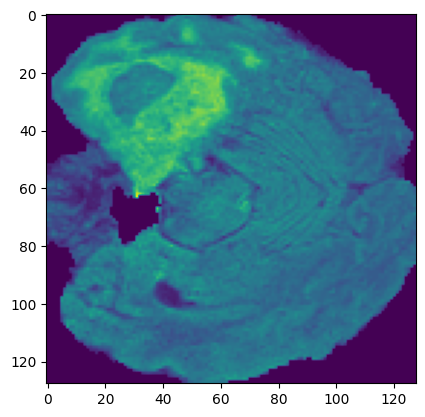

y


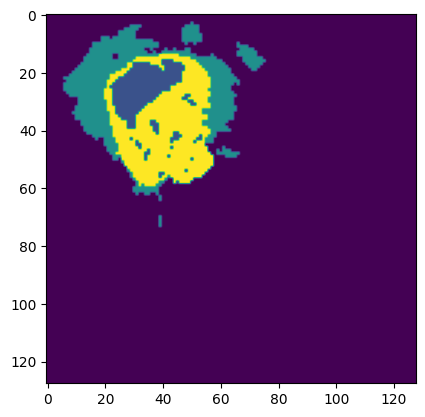

new
x


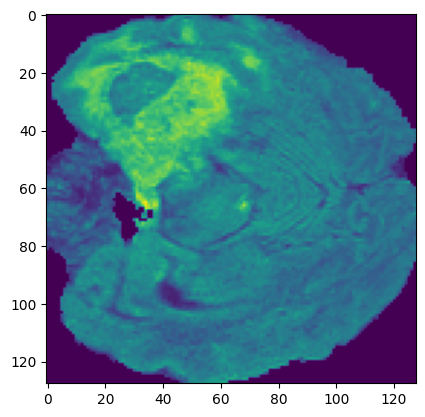

y


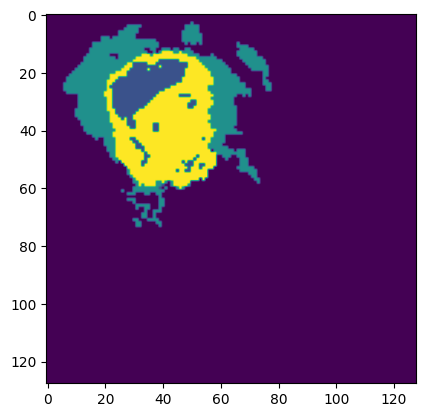

new
x


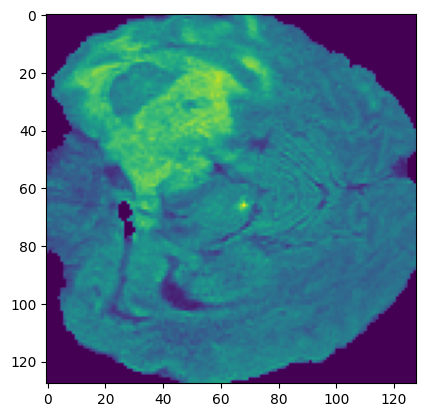

y


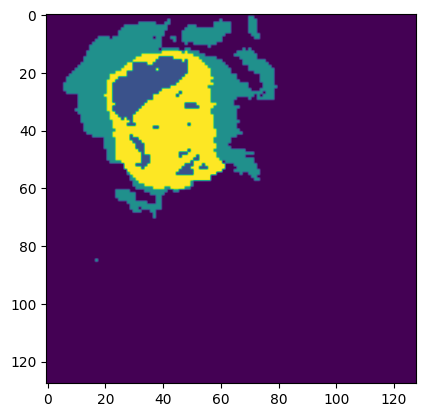

new
x


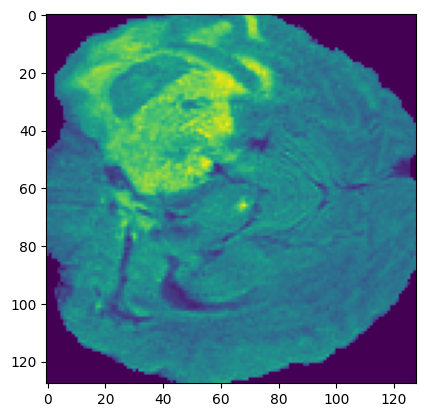

y


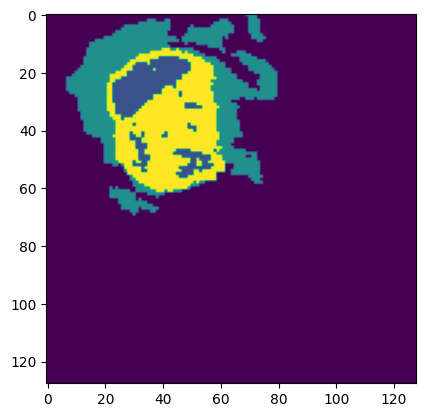

new
x


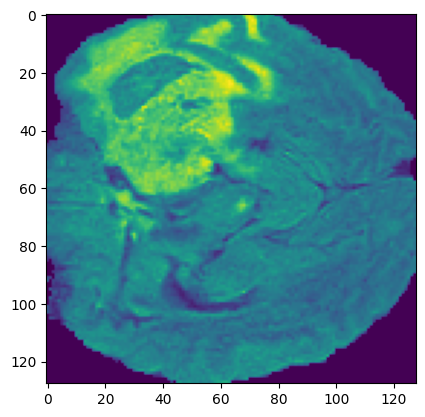

y


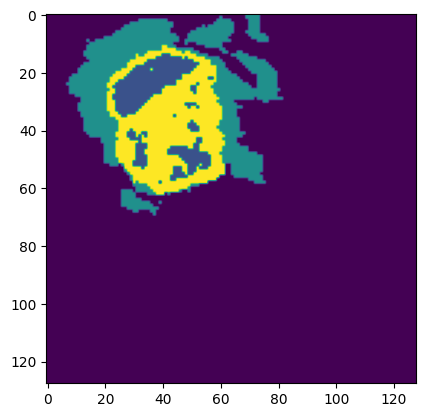

new
x


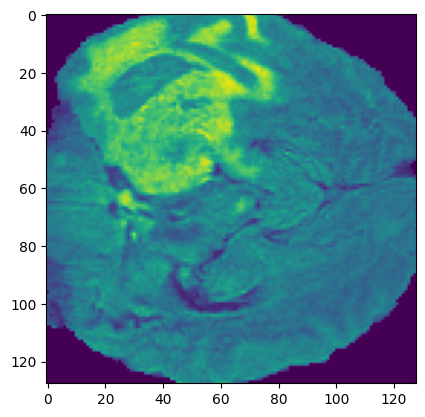

y


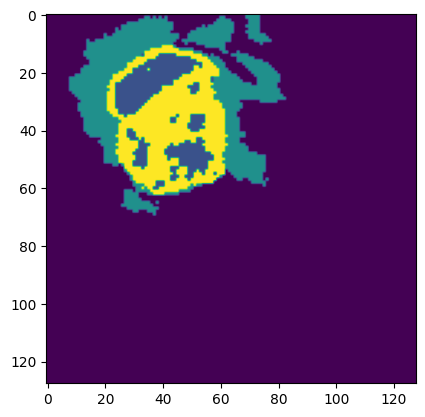

new
x


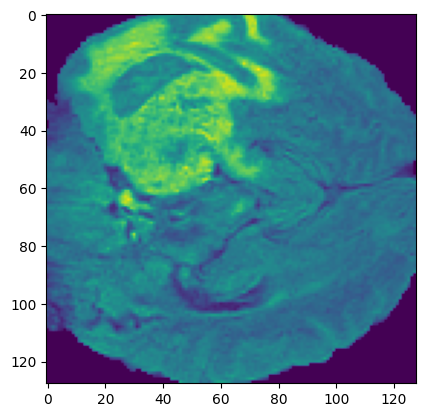

y


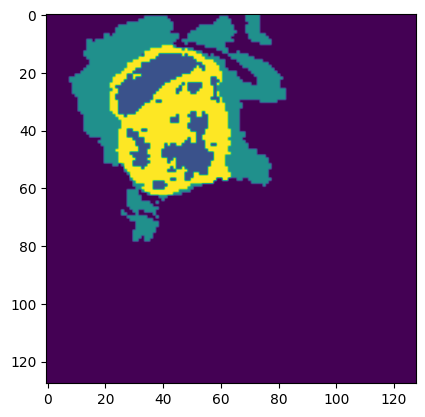

new
x


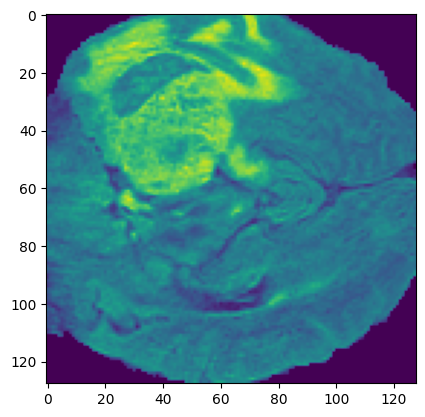

y


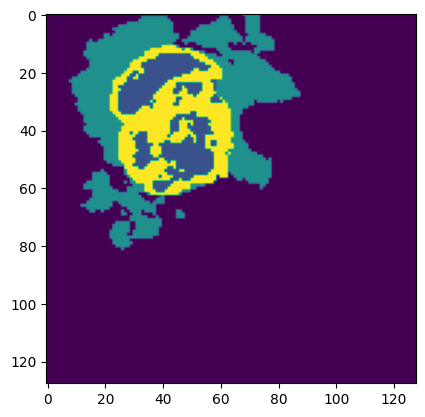

new
x


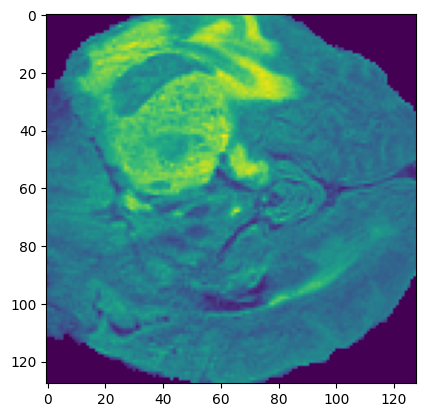

y


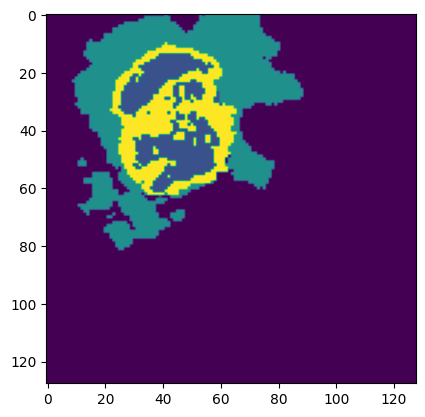

new
x


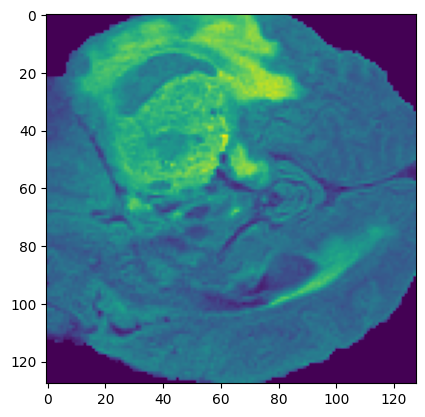

y


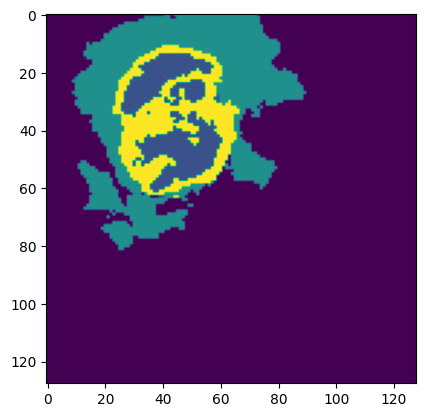

new
x


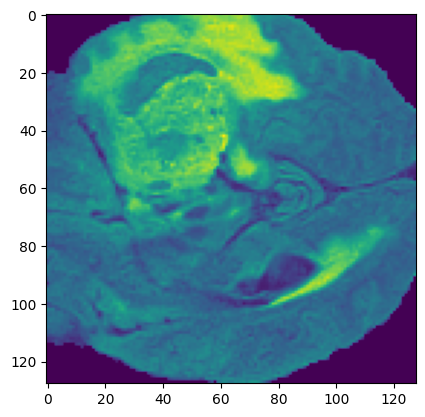

y


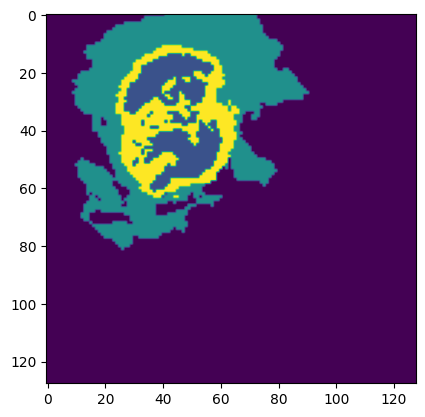

new
x


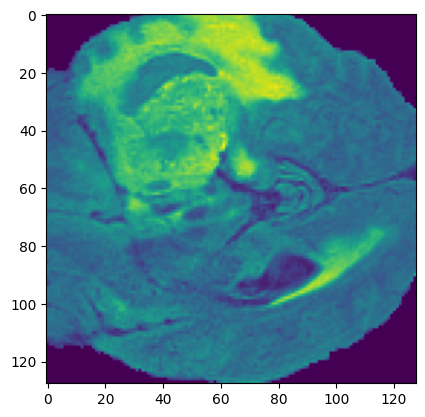

y


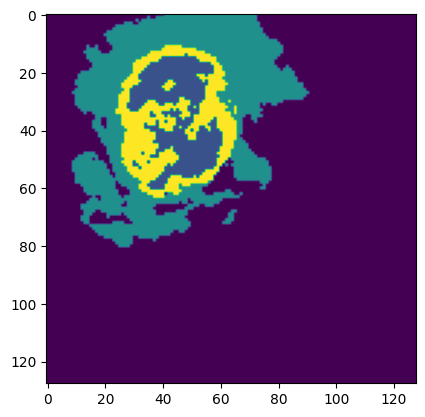

new
x


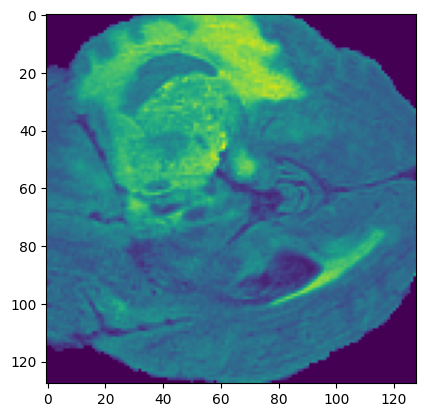

y


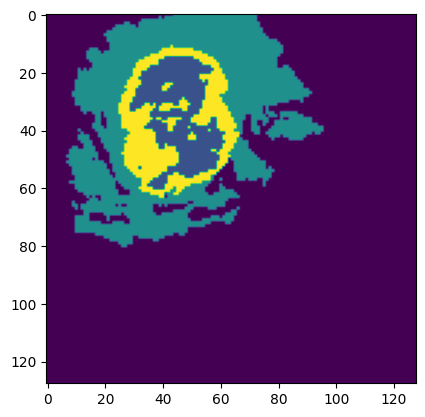

new
x


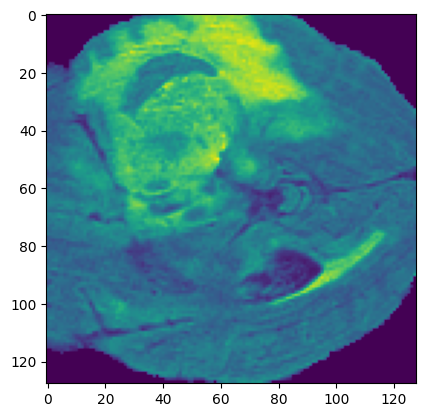

y


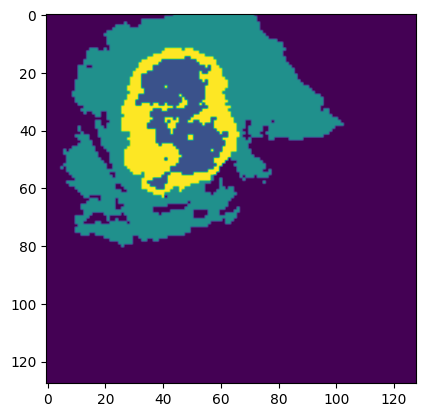

new
x


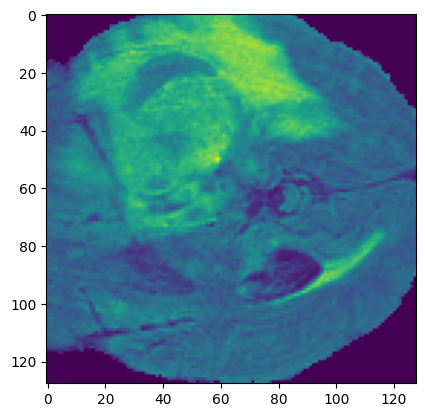

y


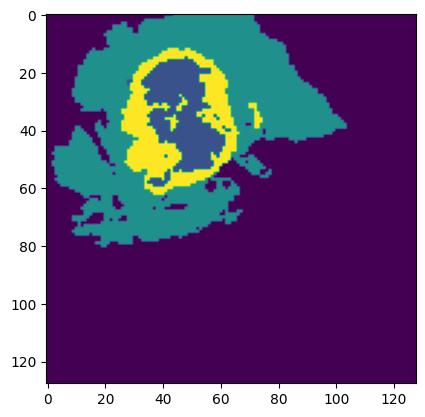

new
x


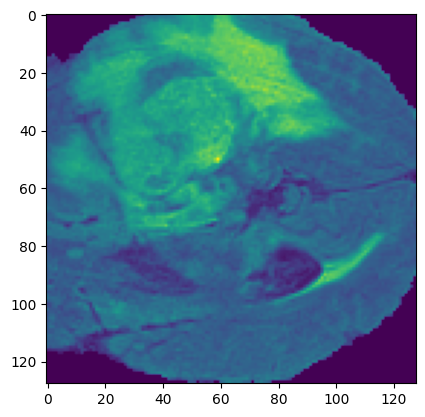

y


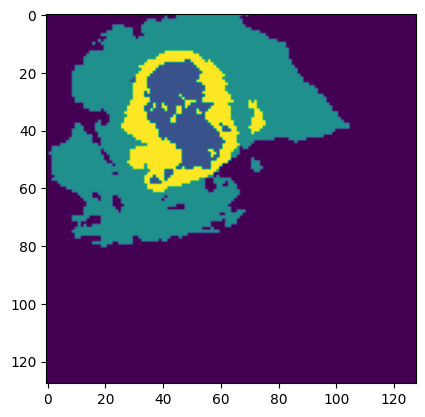

new
x


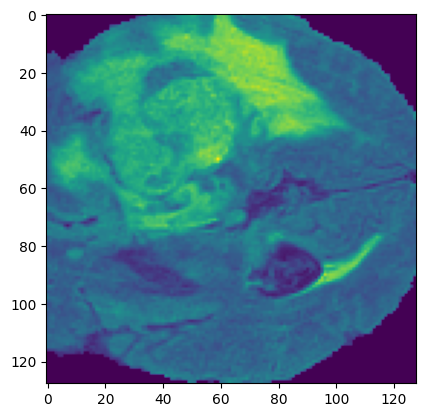

y


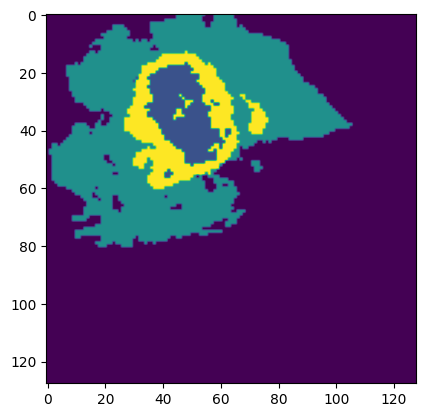

new
x


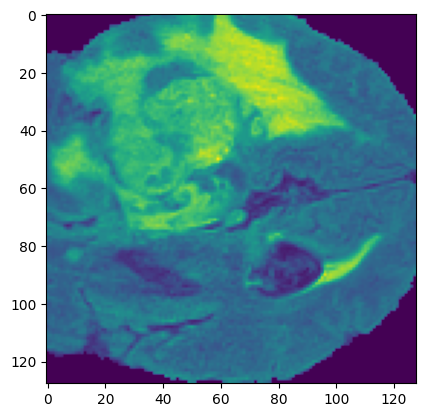

y


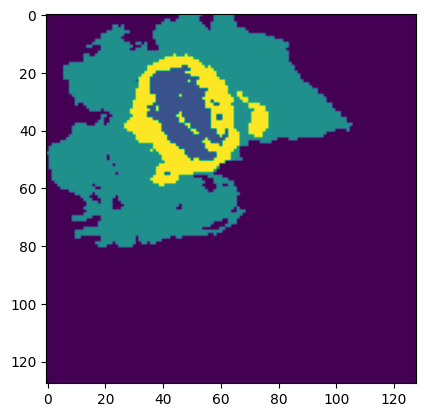

new
x


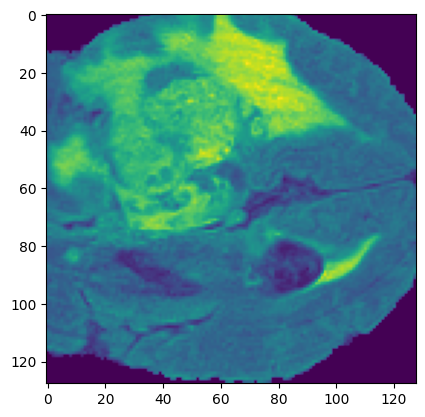

y


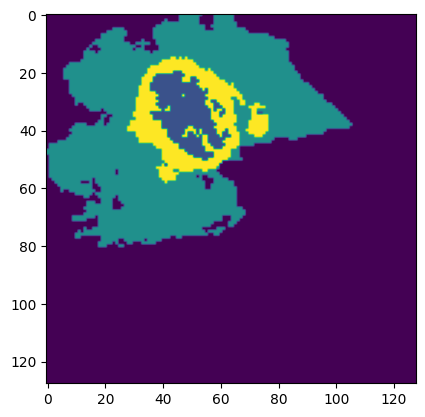

new
x


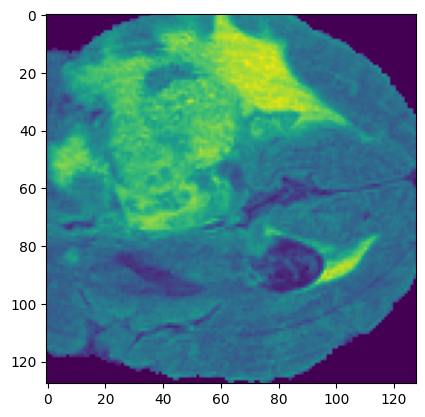

y


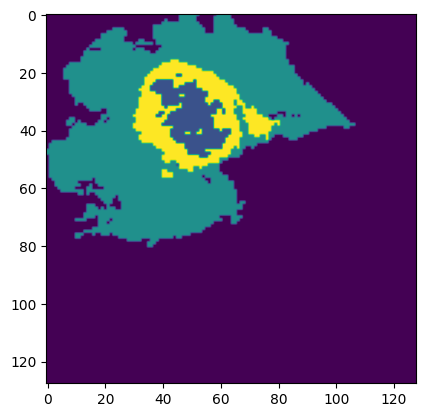

new
x


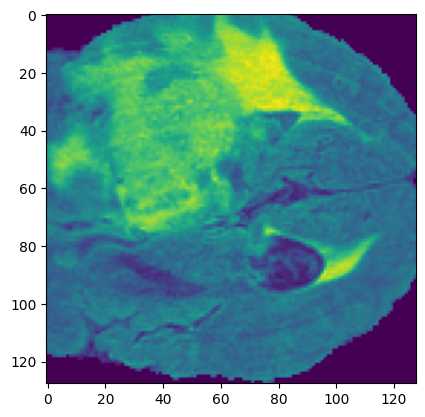

y


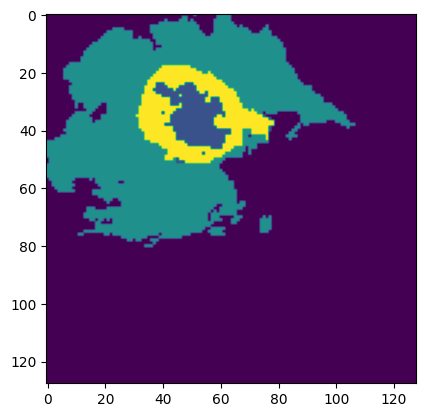

new
x


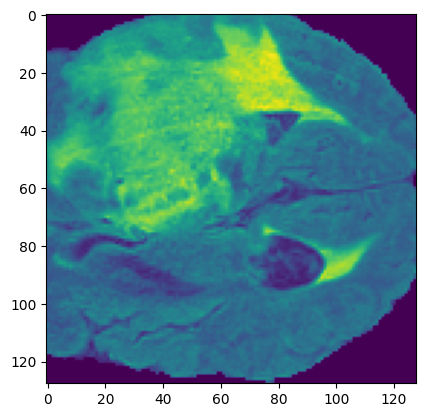

y


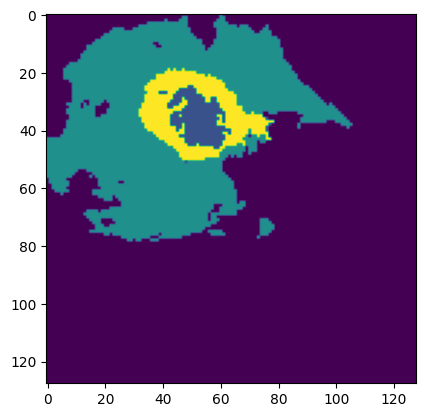

new
x


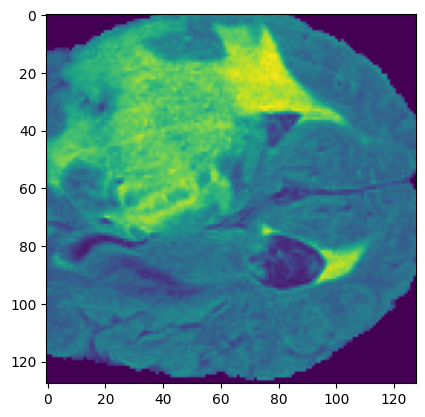

y


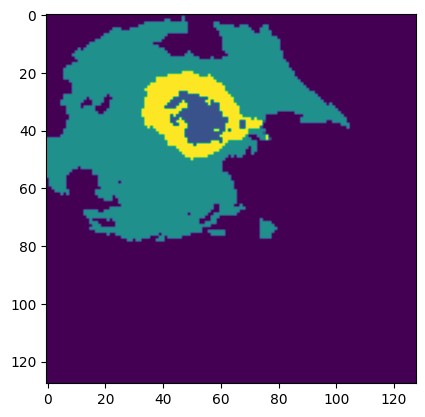

new
x


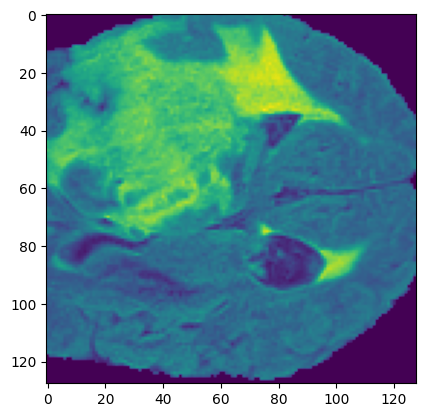

y


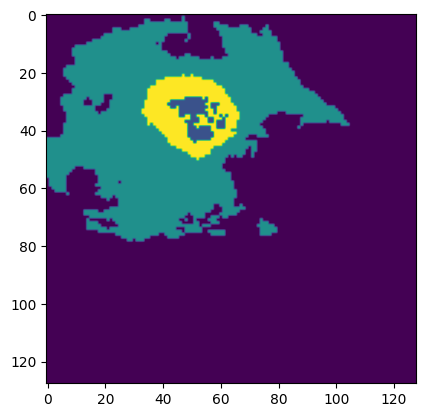

new
x


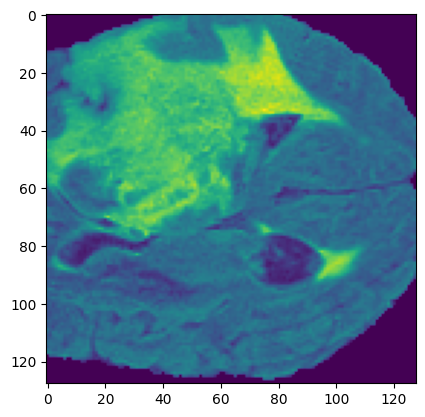

y


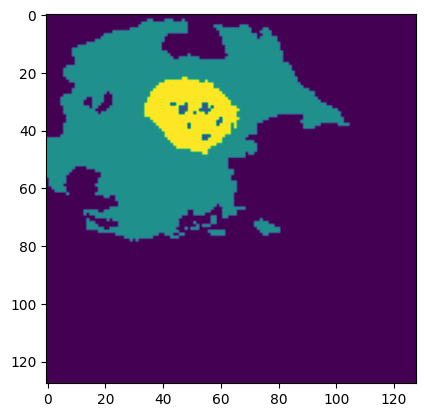

new
x


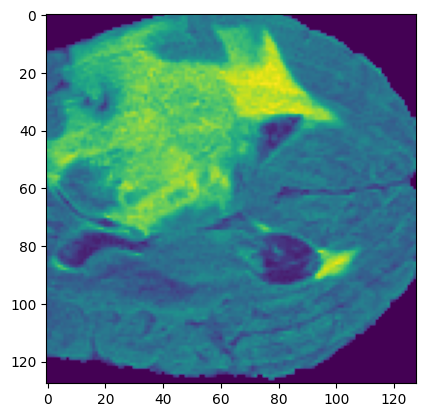

y


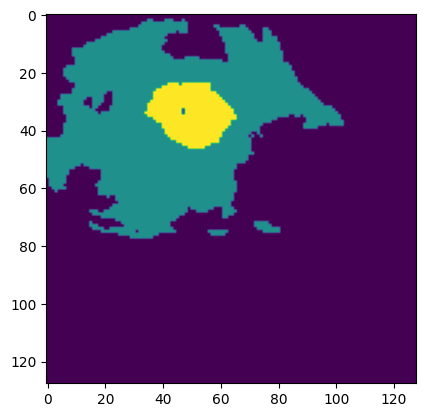

new
x


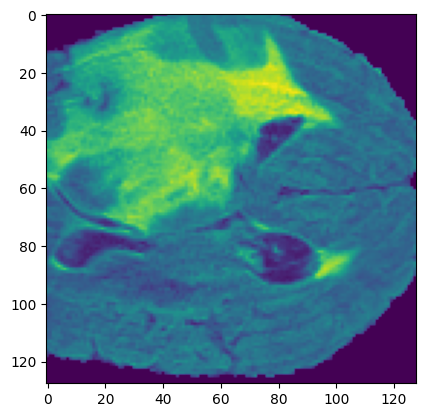

y


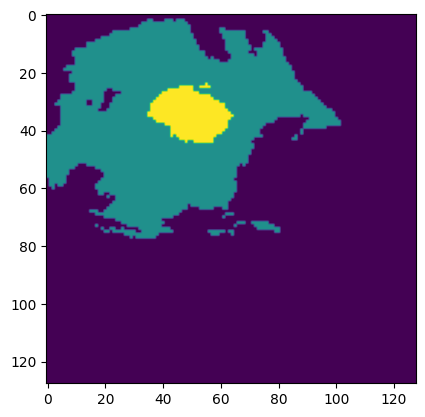

new
x


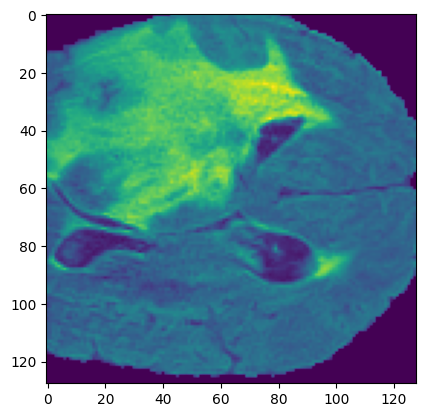

y


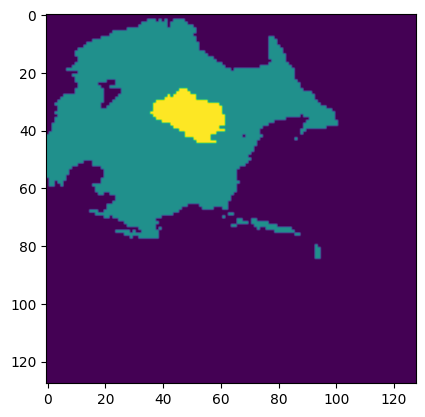

new
x


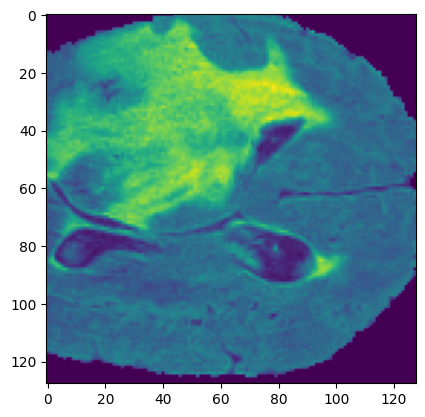

y


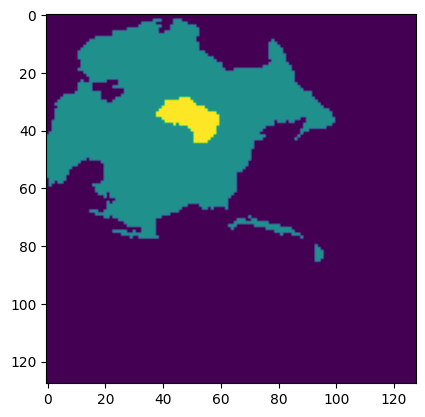

new
x


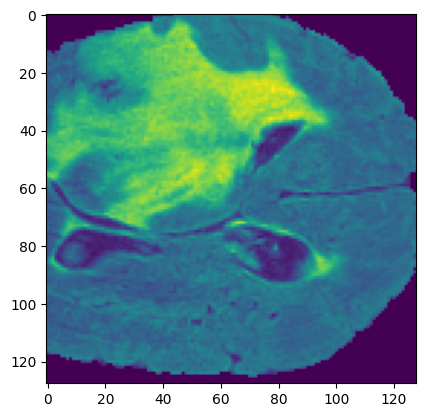

y


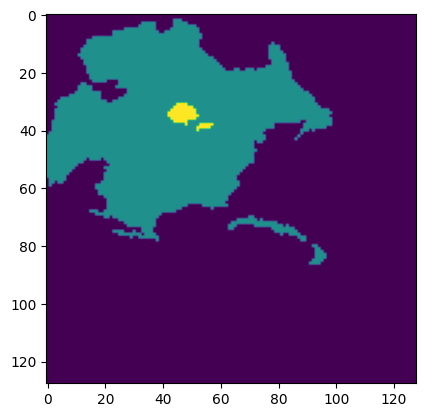

new
x


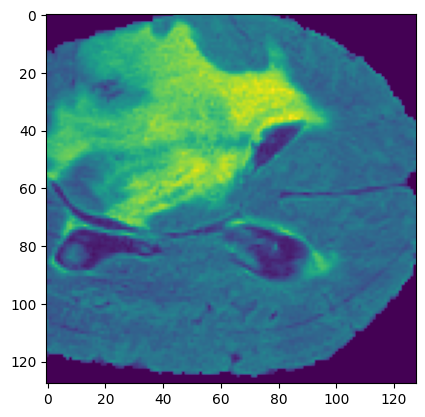

y


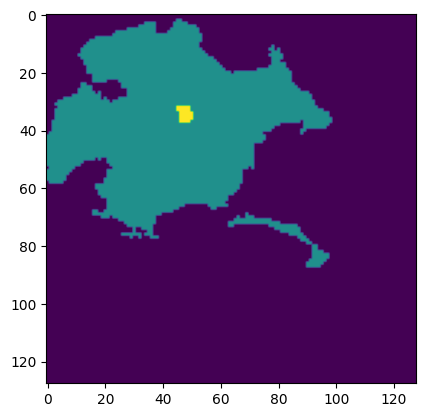

new
x


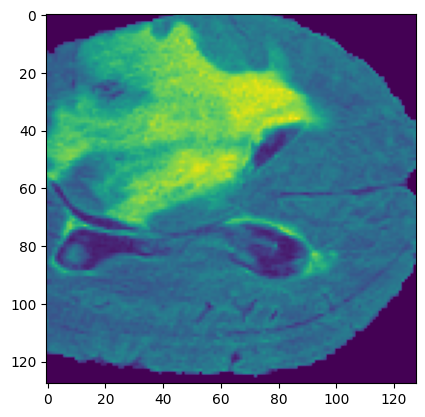

y


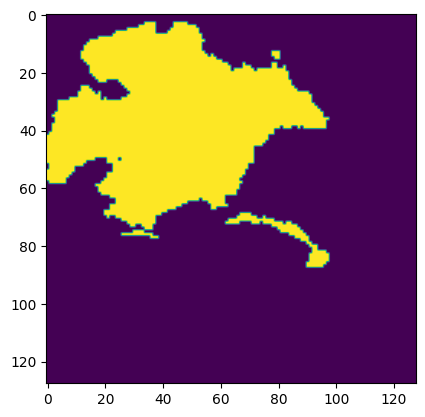

new
x


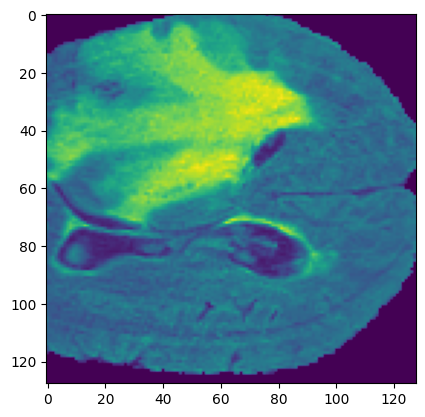

y


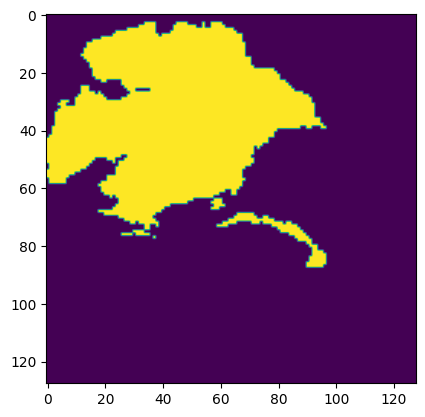

new
x


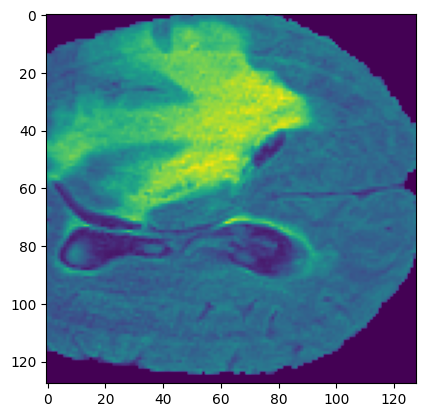

y


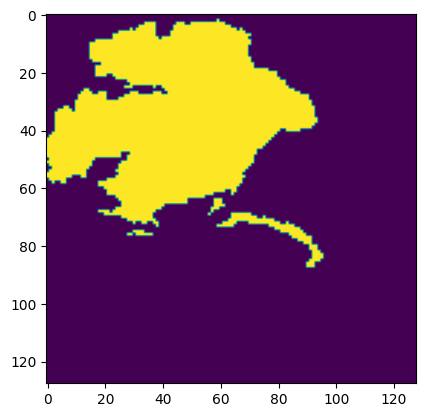

new
x


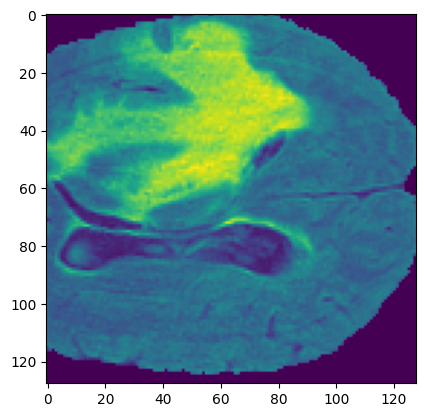

y


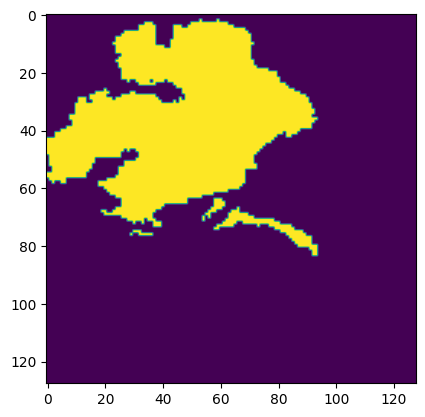

new
x


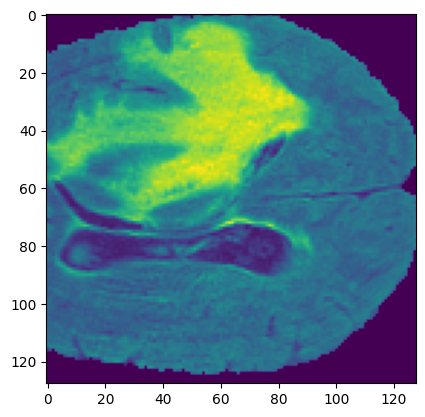

y


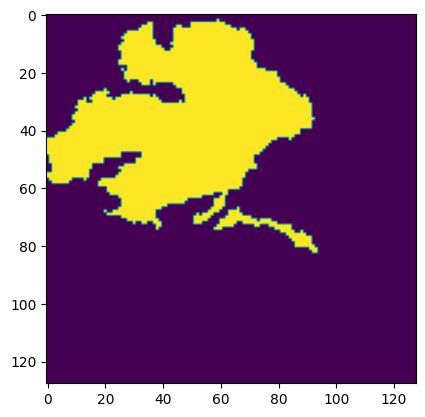

new
x


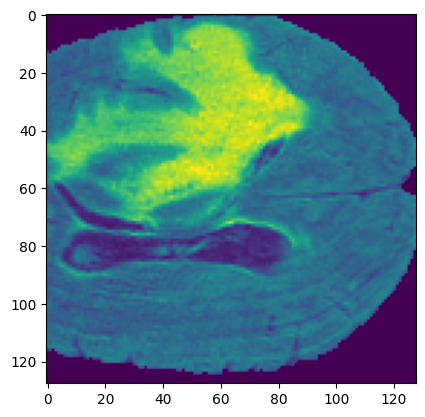

y


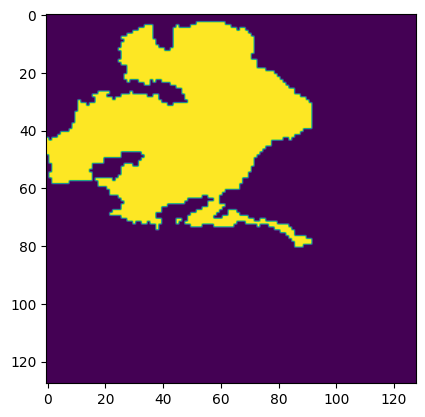

new
x


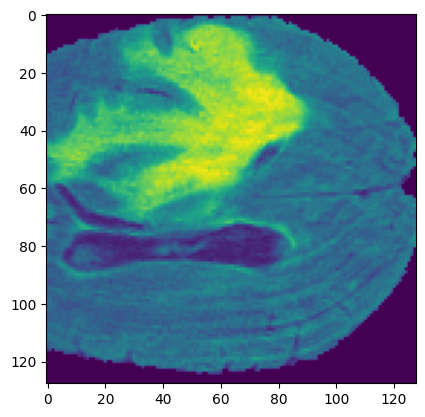

y


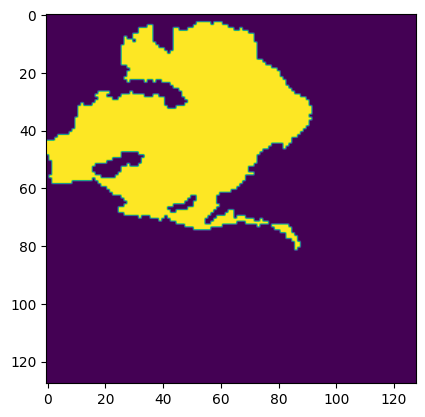

new
x


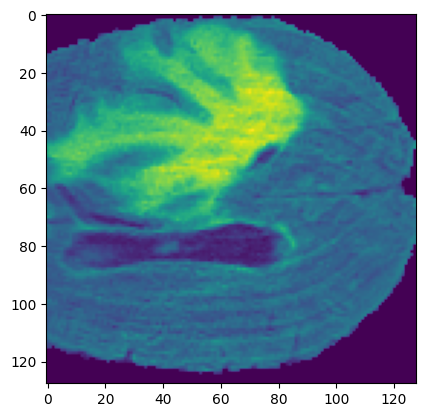

y


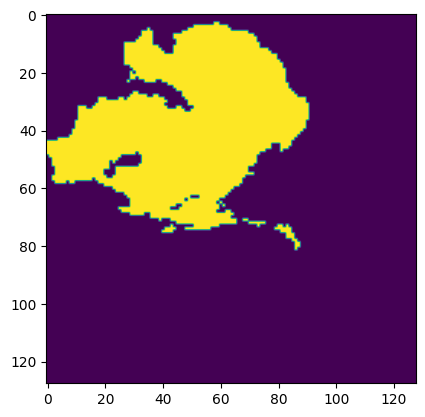

new
x


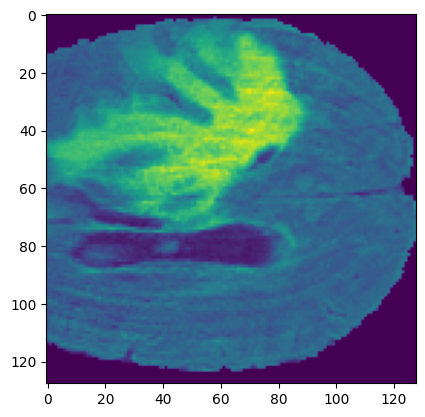

y


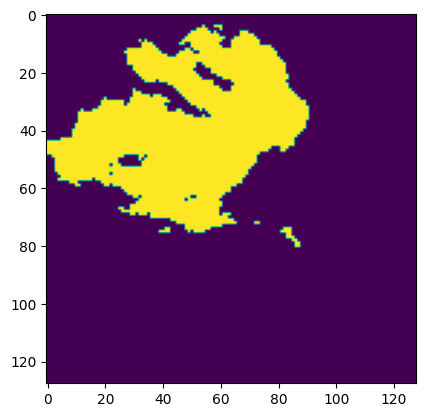

new
x


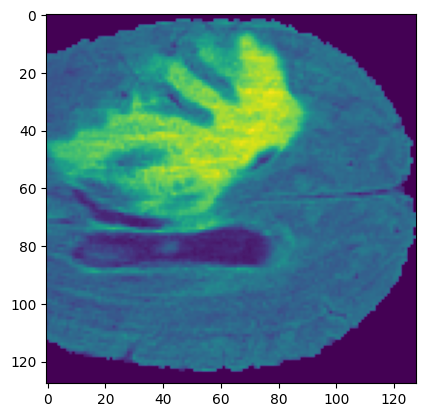

y


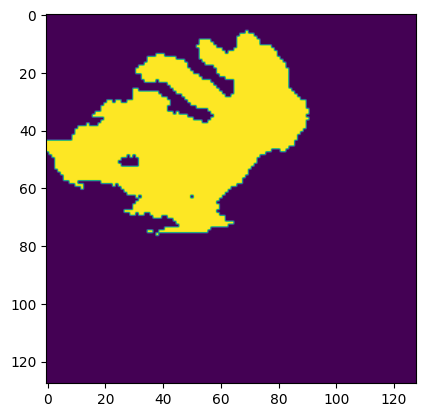

new
x


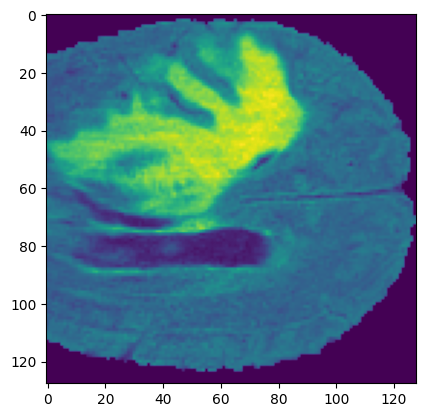

y


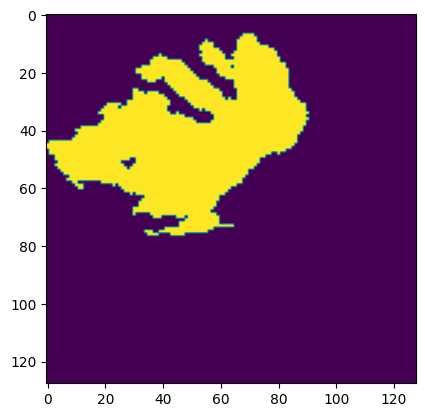

new
x


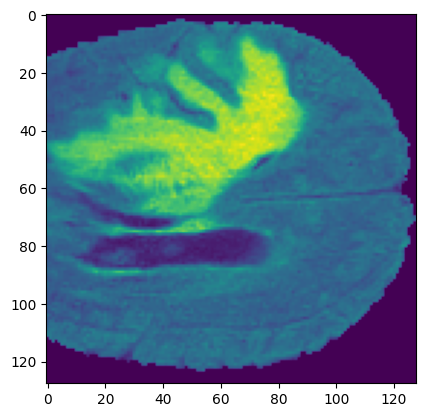

y


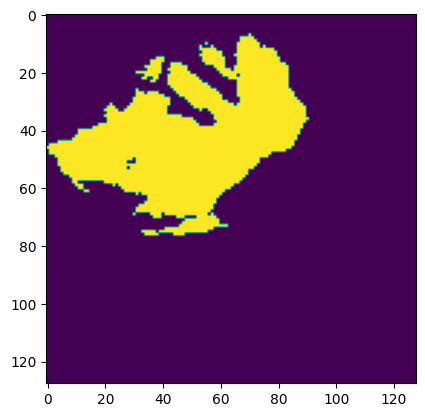

new
x


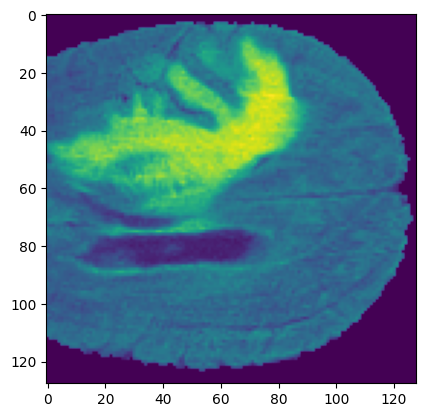

y


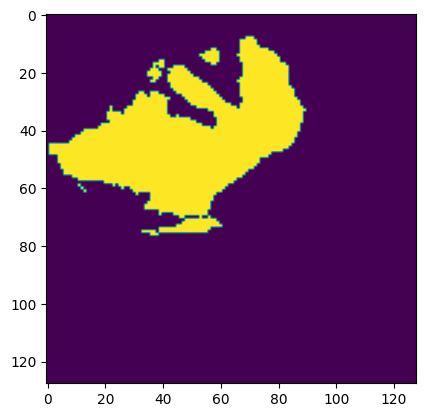

new
x


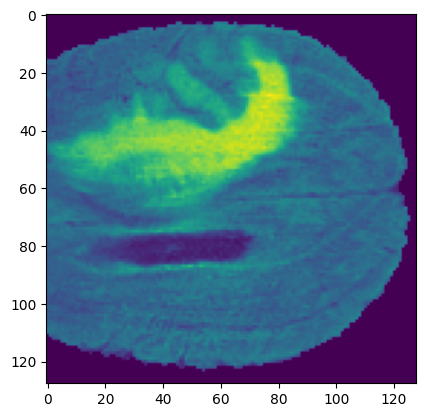

y


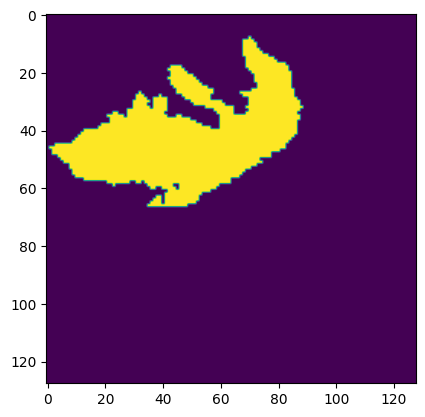

new
x


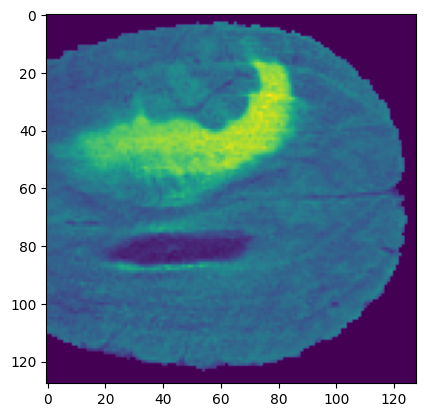

y


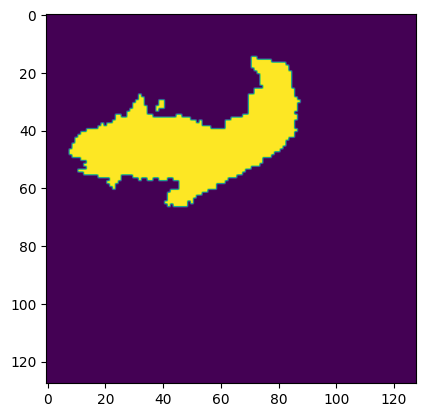

new
x


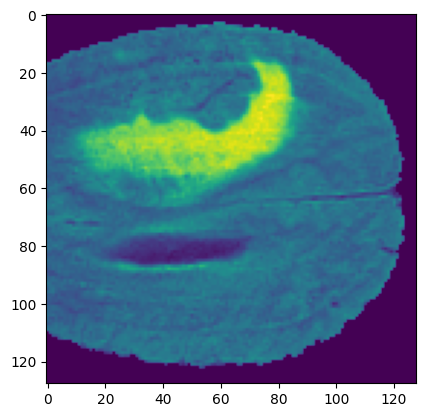

y


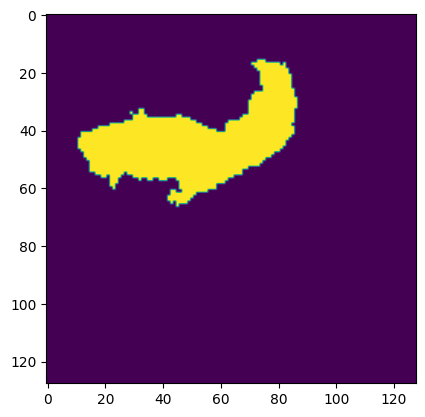

new
x


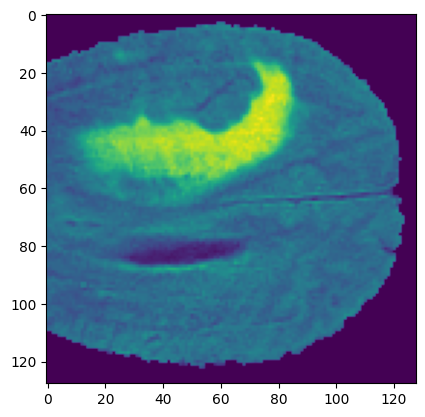

y


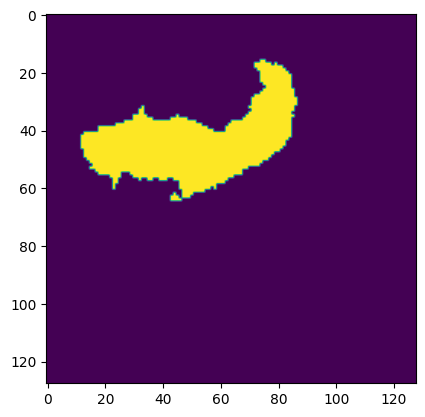

new
x


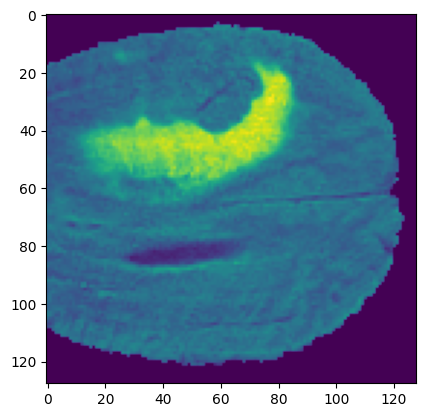

y


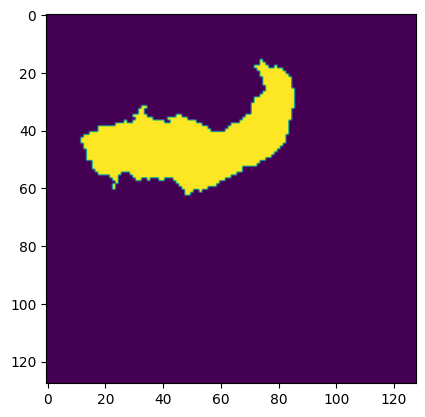

new
x


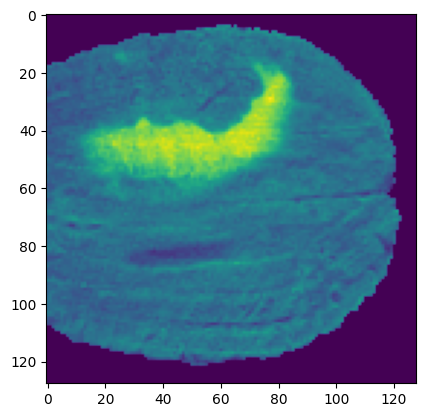

y


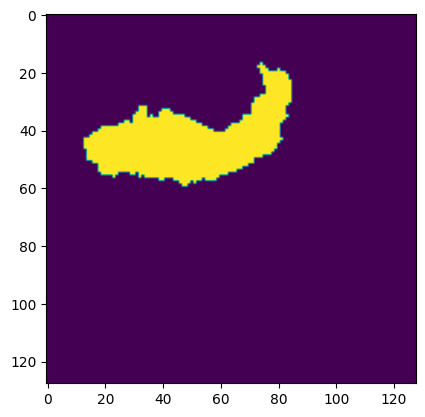

new
x


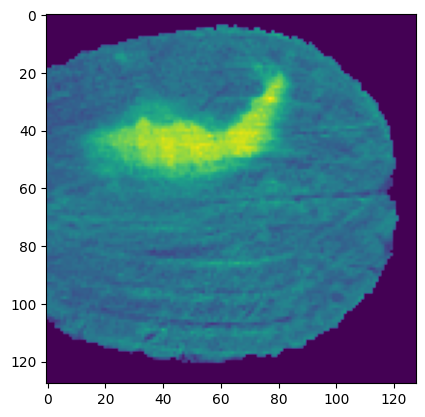

y


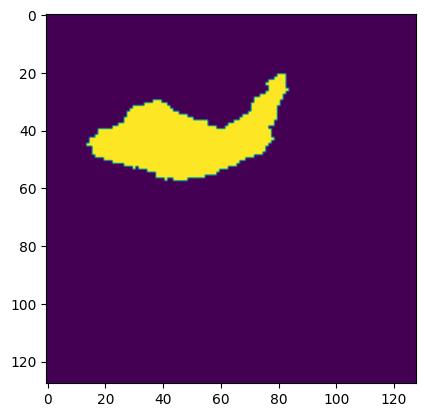

new
x


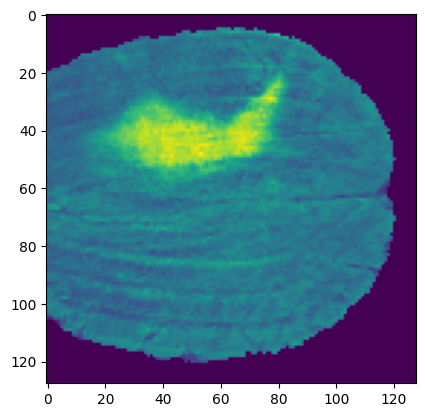

y


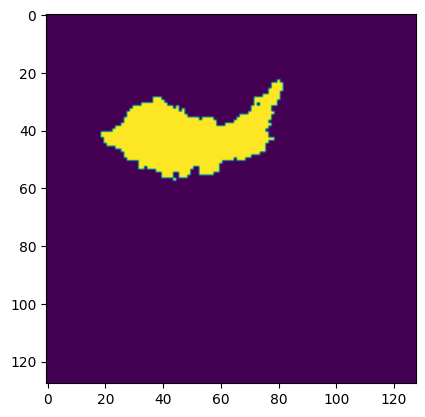

new
x


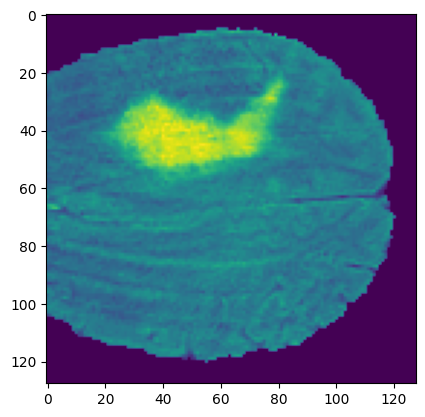

y


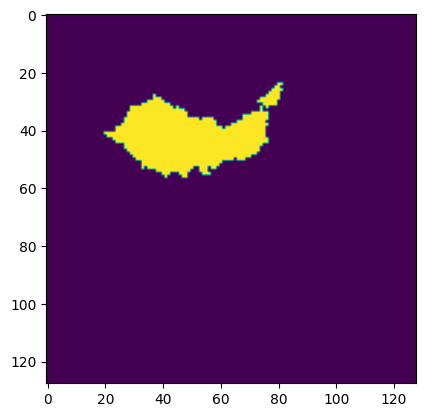

new
x


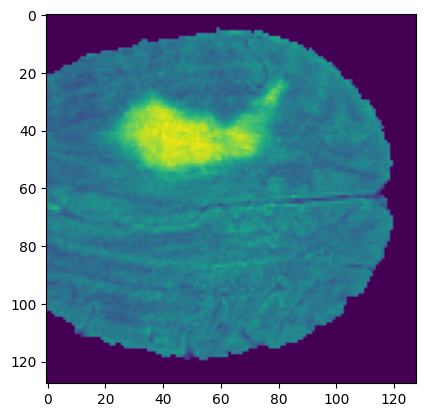

y


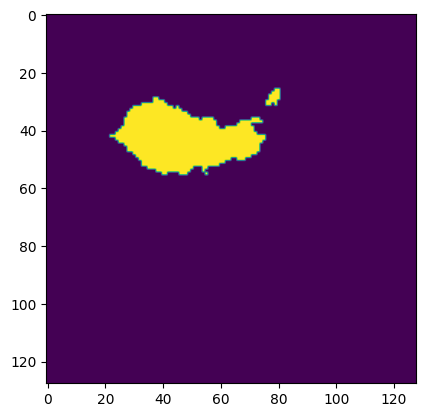

new
x


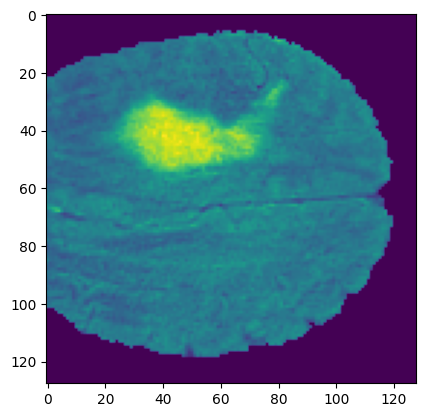

y


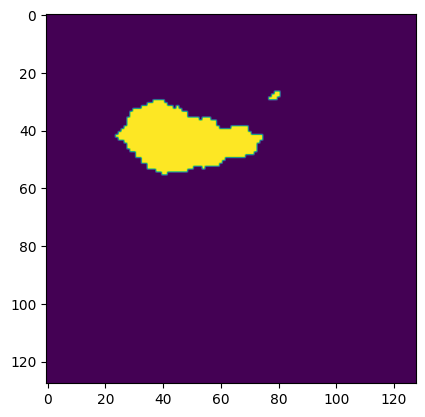

new
x


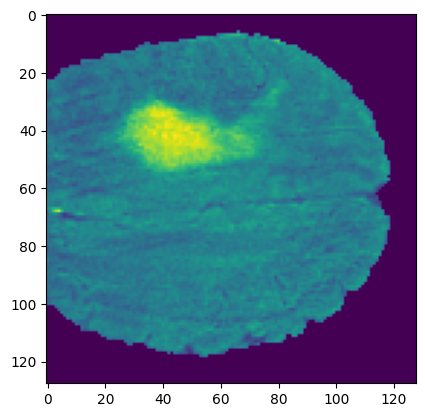

y


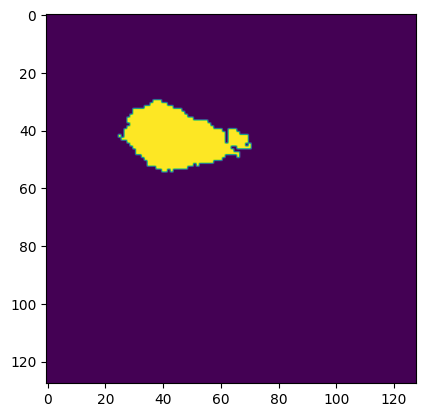

new
x


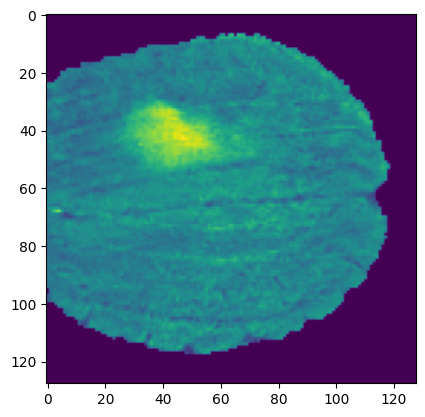

y


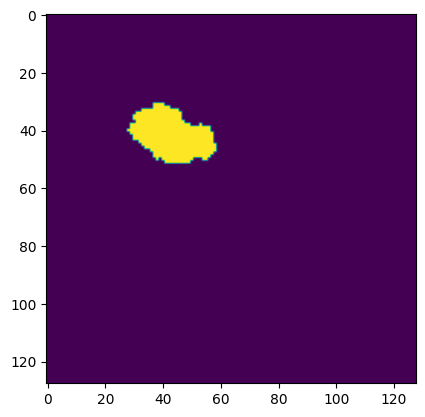

new
x


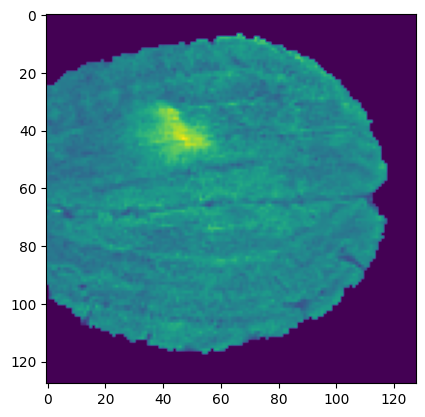

y


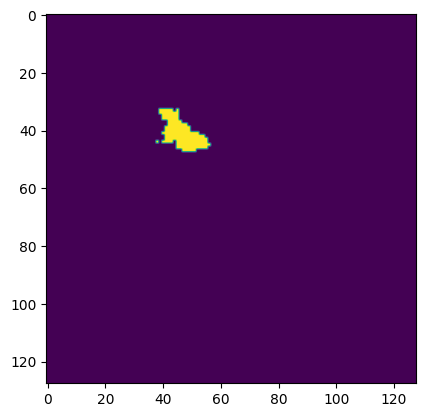

new
x


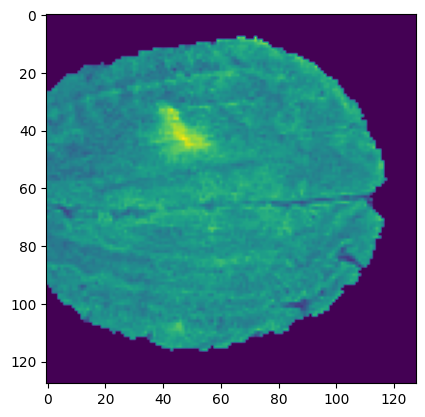

y


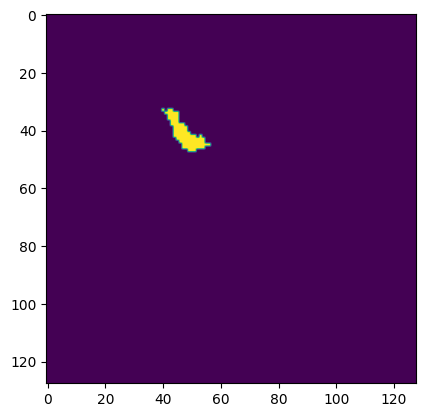

new
x


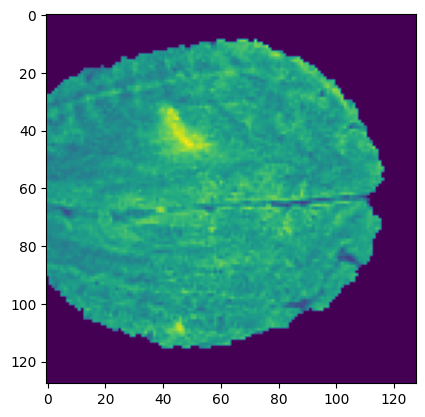

y


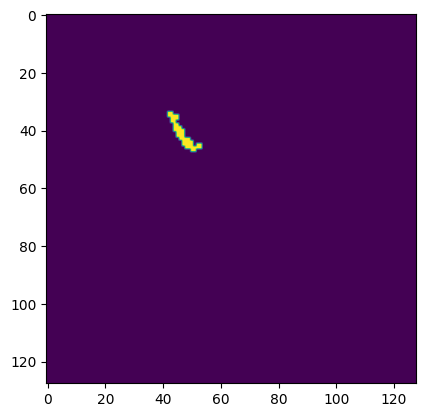

new
x


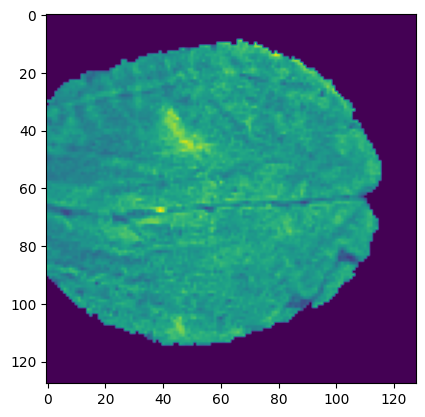

y


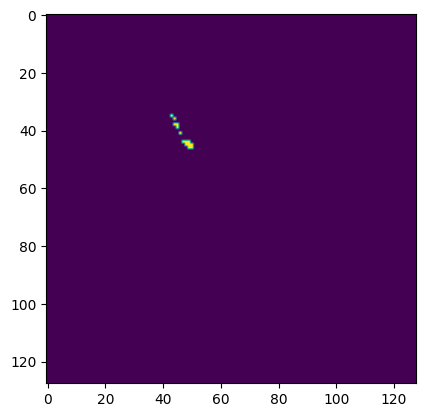

new
x


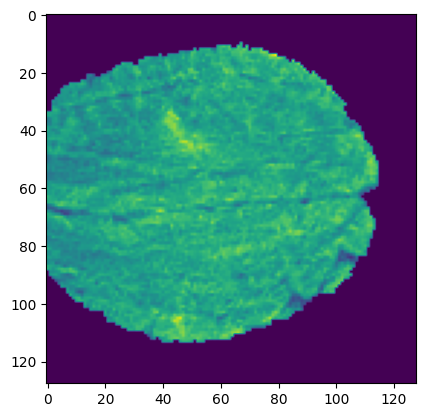

y


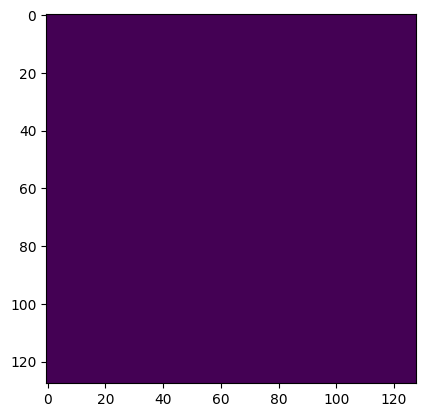

new
x


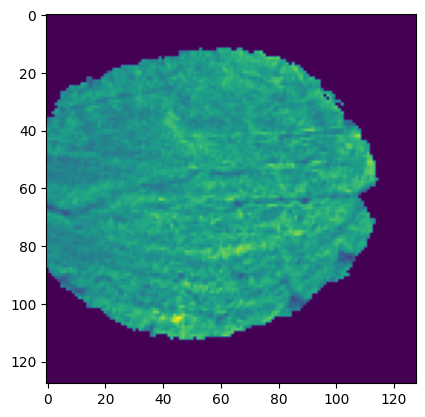

y


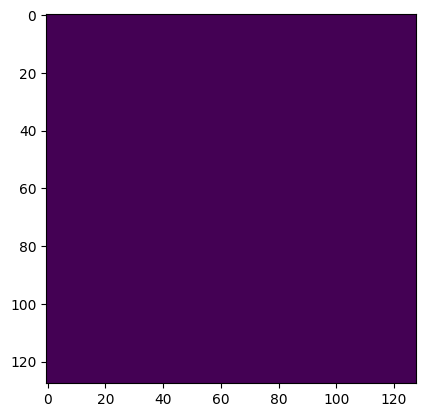

new
x


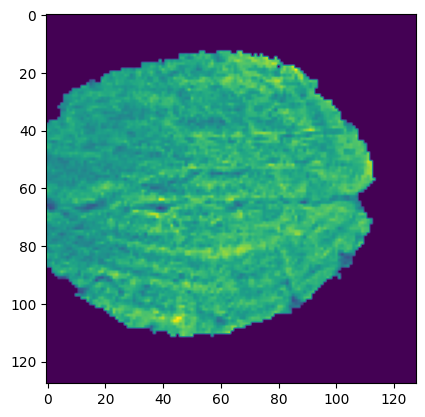

y


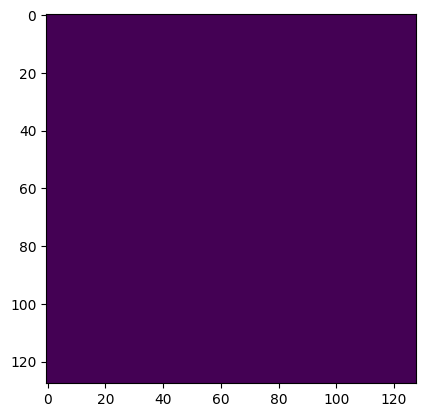

new
x


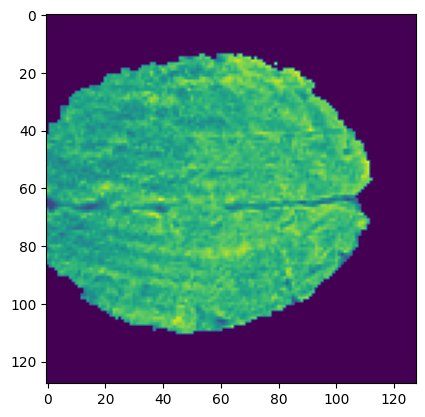

y


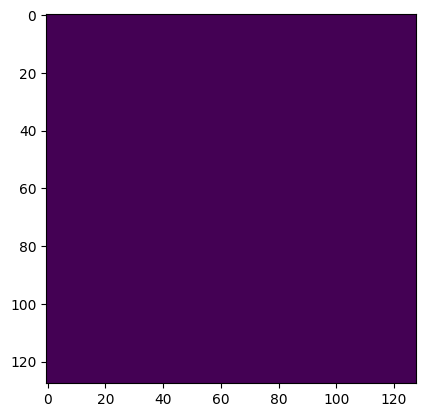

new
x


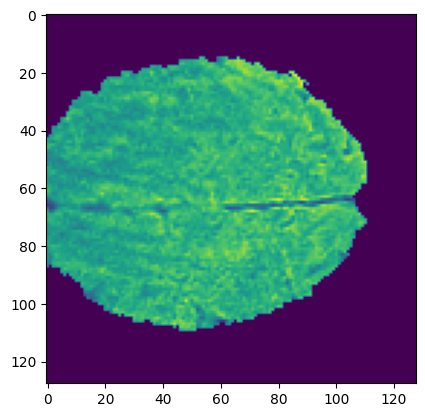

y


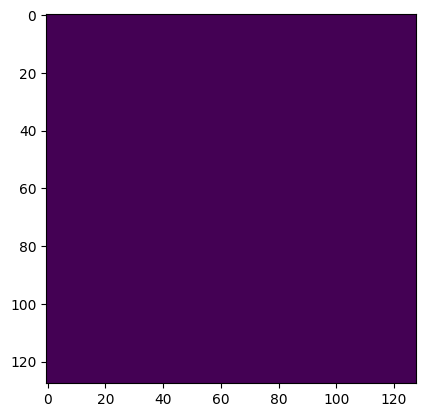

new
x


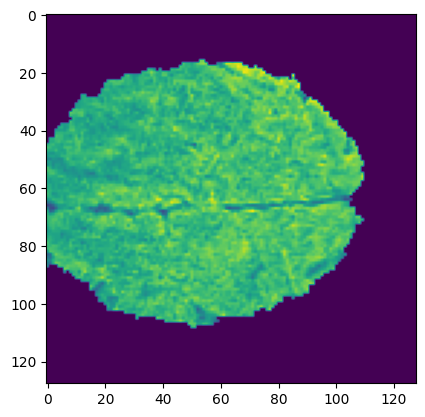

y


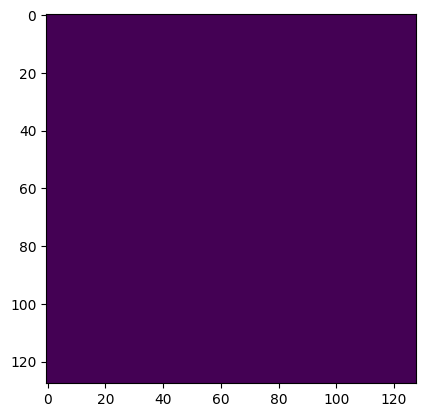

new
x


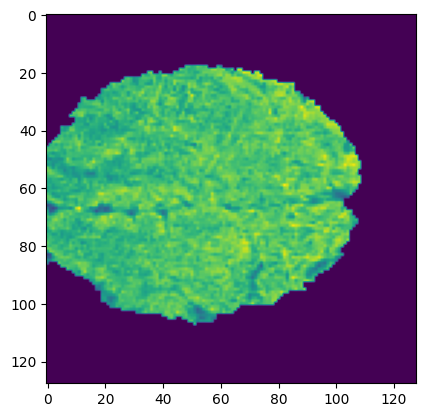

y


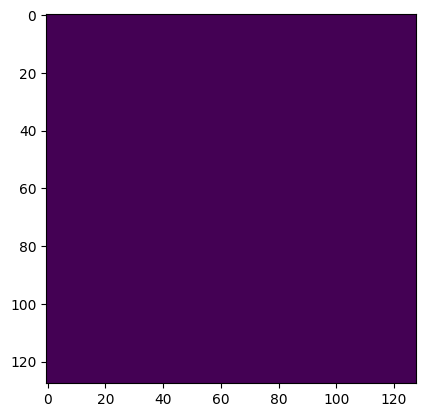

new
x


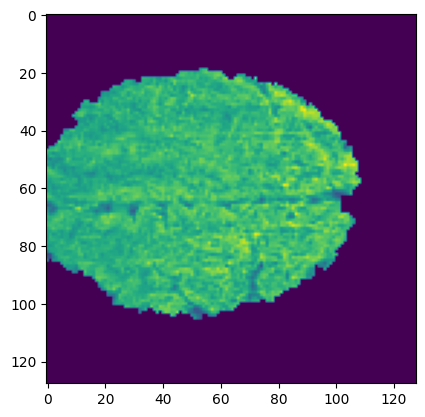

y


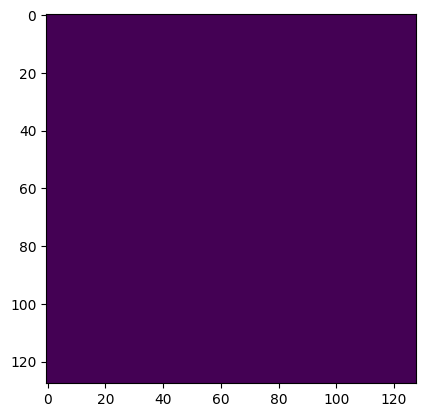

new
x


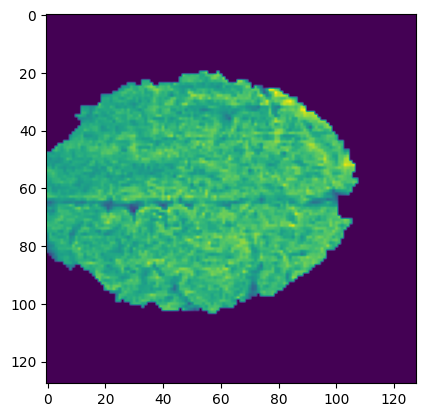

y


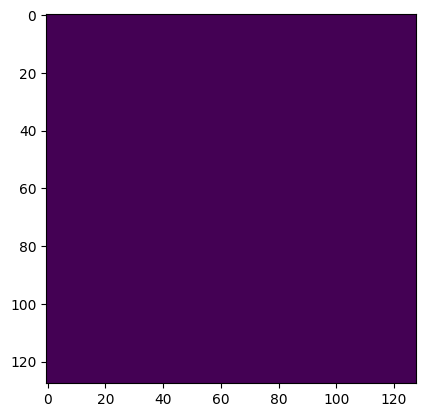

new
x


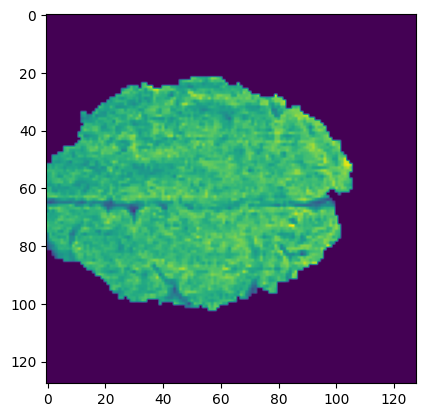

y


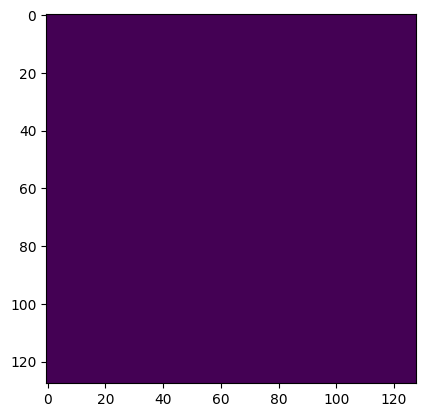

new
x


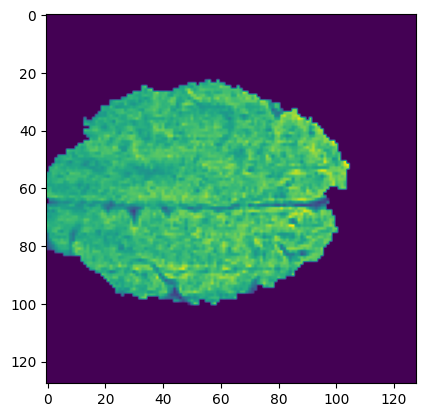

y


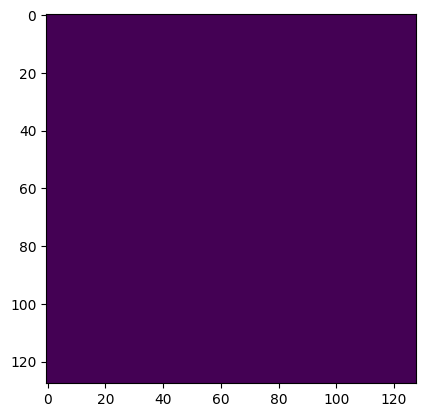

new
x


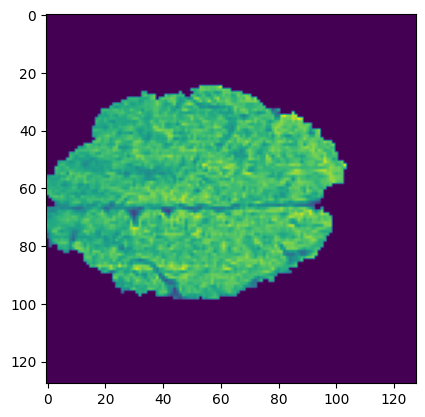

y


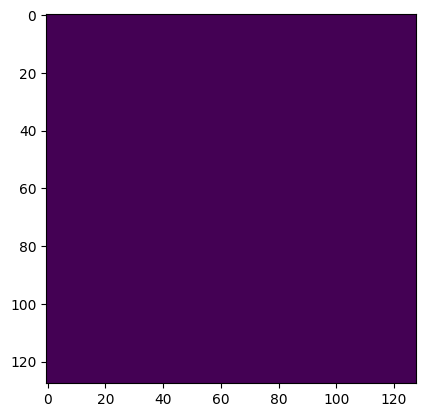

new
x


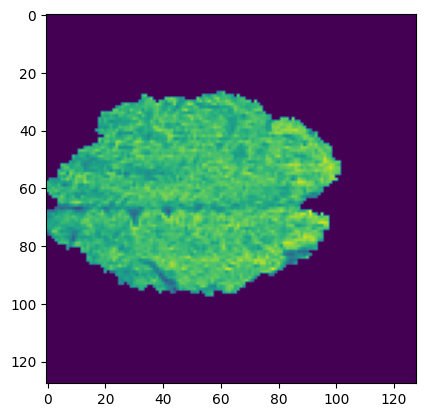

y


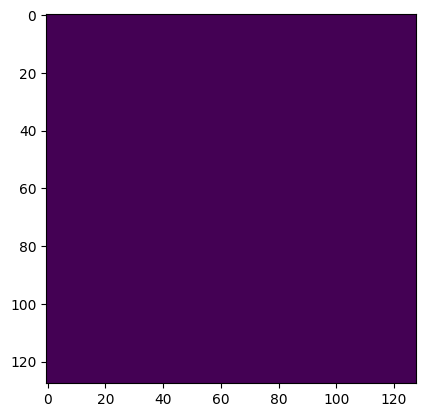

new
x


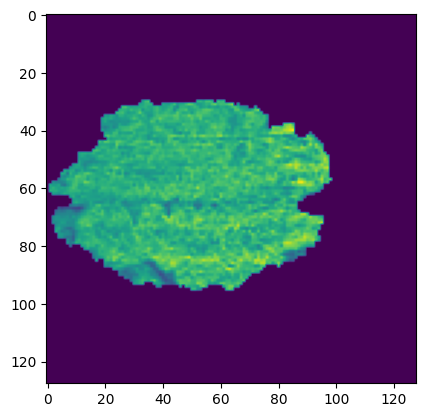

y


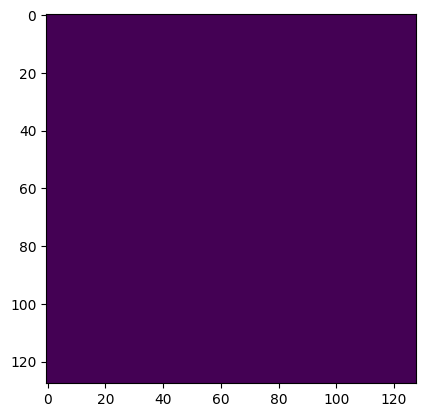

new
x


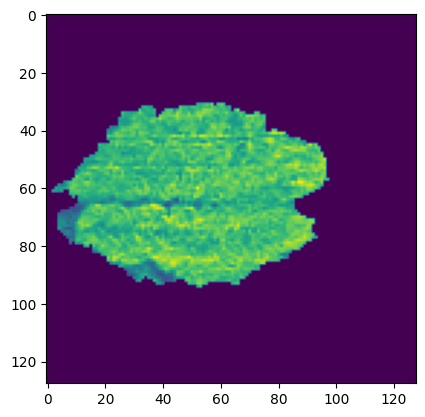

y


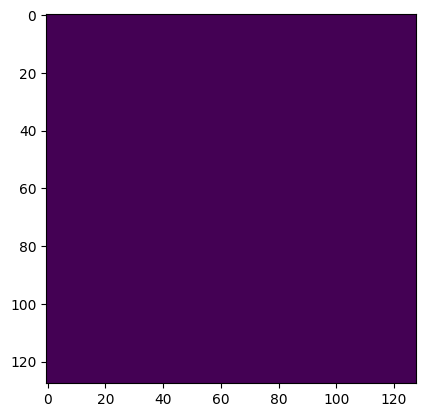

new
x


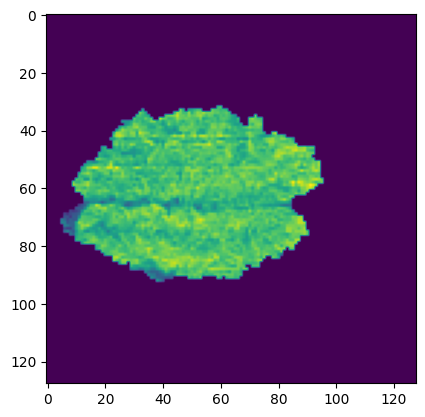

y


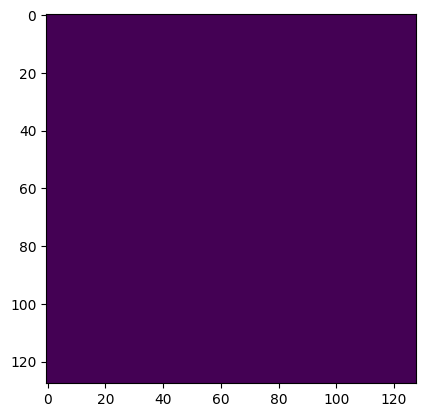

new
x


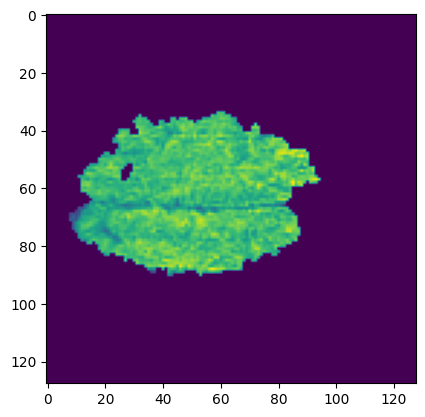

y


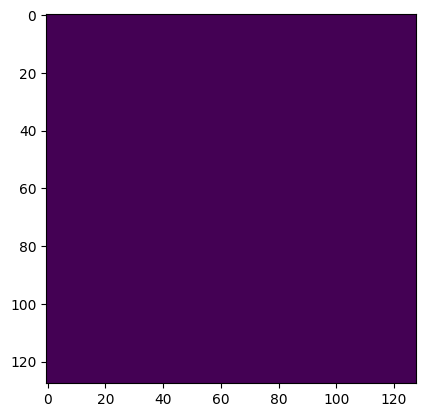

new
x


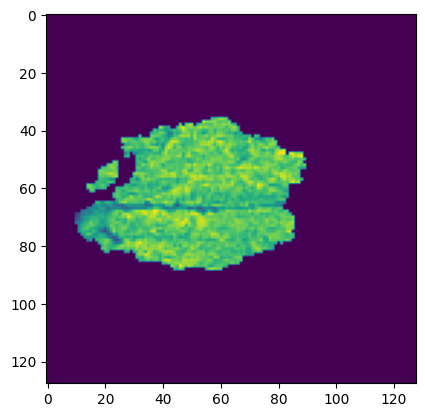

y


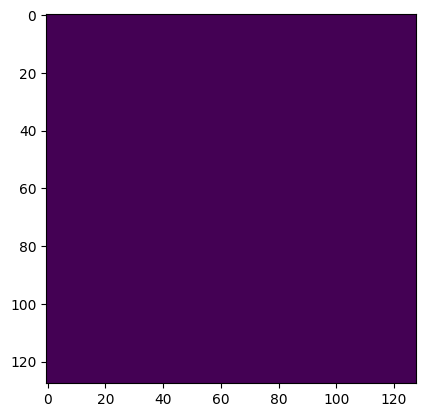

new
x


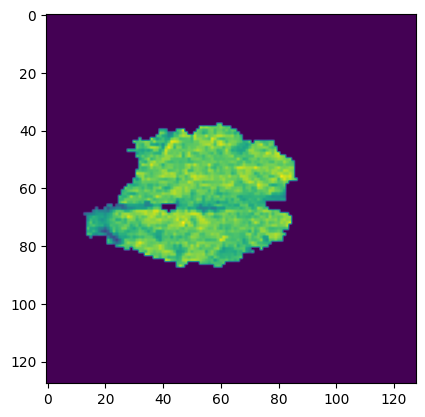

y


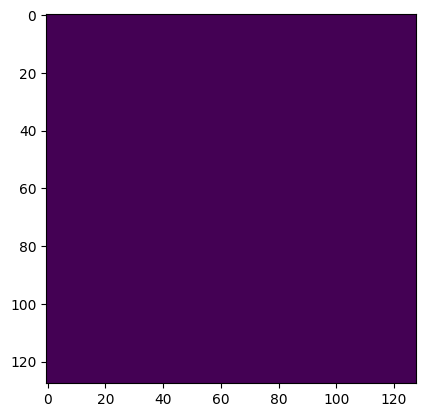

new
x


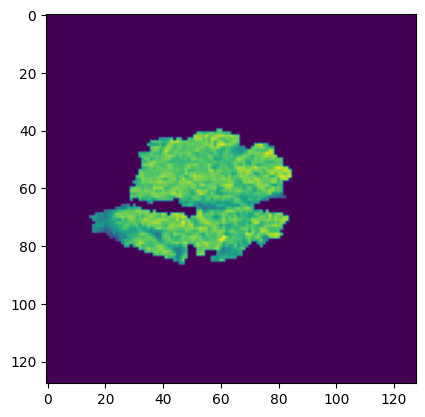

y


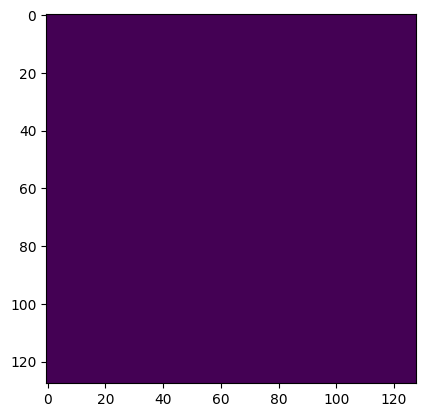

new
x


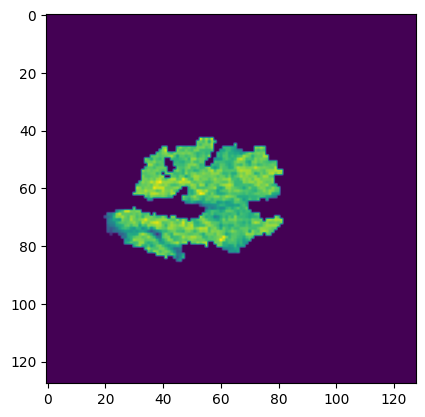

y


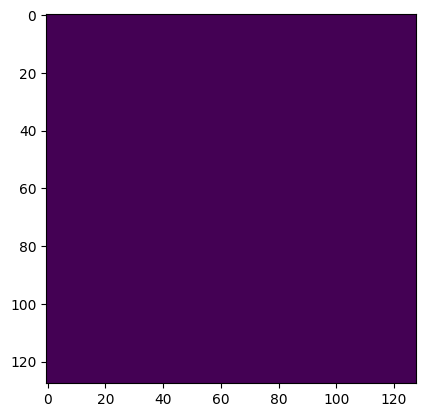

new
x


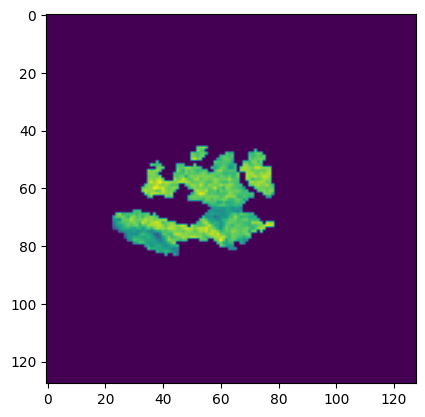

y


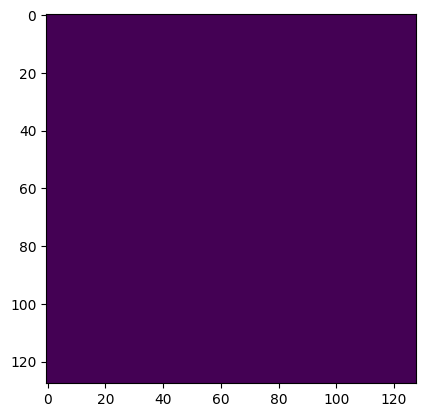

new
x


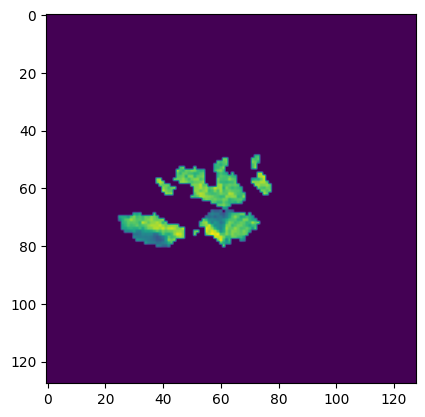

y


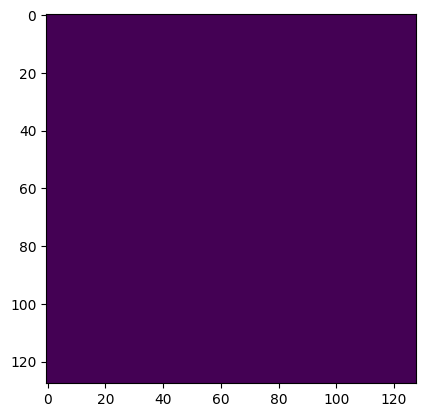

new
x


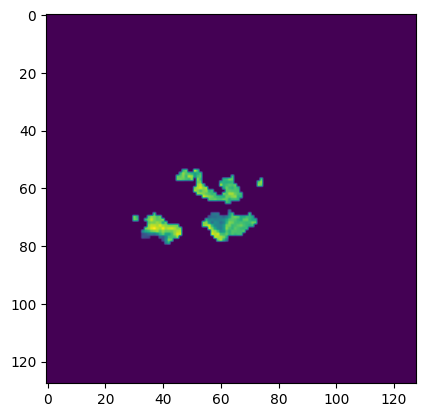

y


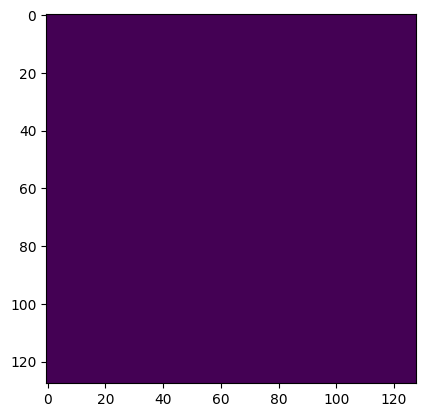

new
x


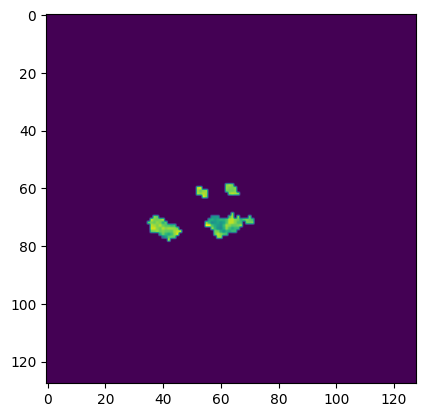

y


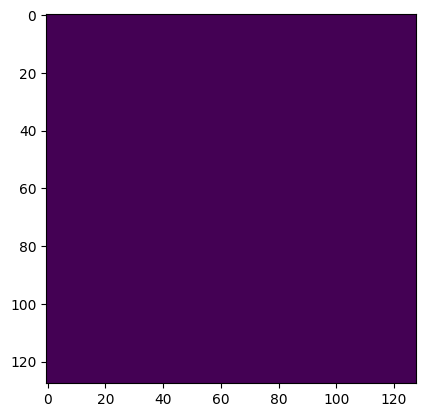

new
x


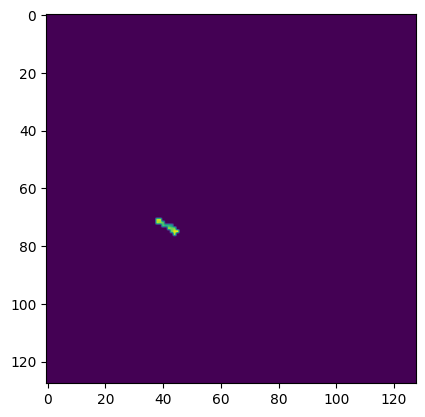

y


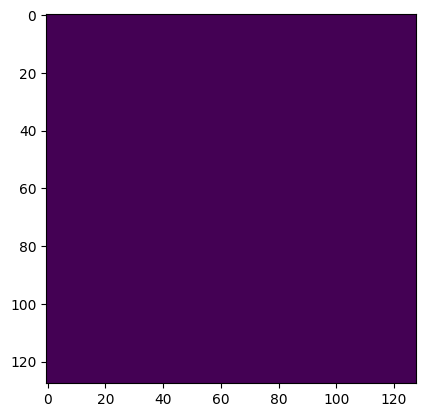

new
x


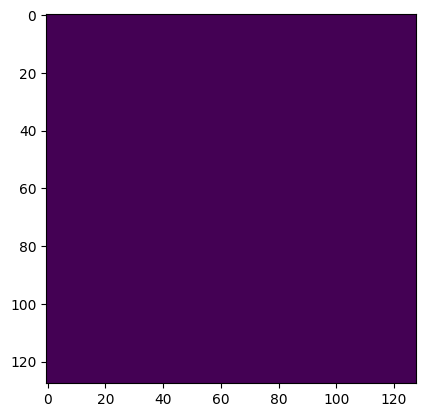

y


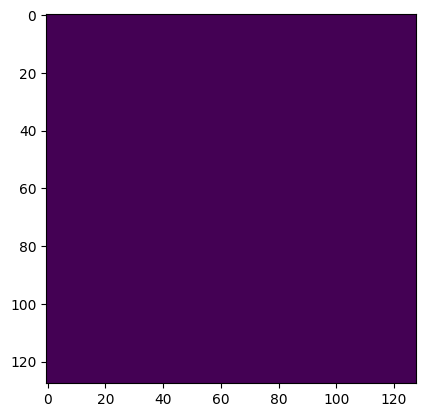

new
x


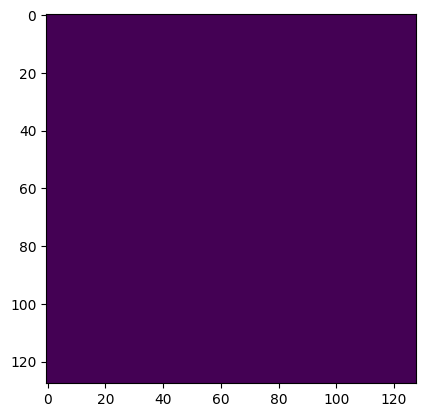

y


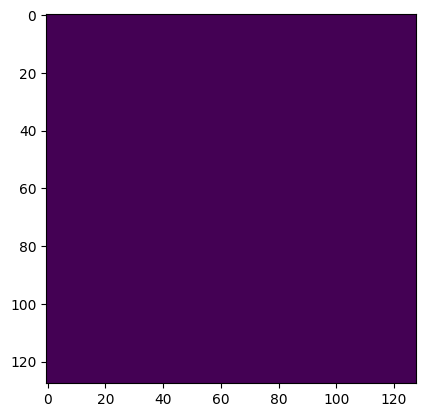

new
(1, 128, 128, 128)
Number of classes [0 1 2 3]


TypeError: too many positional arguments

In [25]:
%pip install nibabel
%pip install tensorflow
%pip install keras
%pip install matplotlib
%pip install scikit-learn

import os
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt
from keras.models import Model
from keras.layers import Input, Conv3D, MaxPooling3D, Dropout, Conv3DTranspose, concatenate, Activation, BatchNormalization
from keras.optimizers import Adam
from keras.utils import to_categorical
from keras import backend as K
from sklearn.utils import class_weight

def conv_block(input_mat,num_filters,kernel_size,batch_norm):
  X = Conv3D(num_filters,kernel_size=(kernel_size,kernel_size,kernel_size),strides=(1,1,1),padding='same')(input_mat)
  if batch_norm:
    X = BatchNormalization()(X)
  
  X = Activation('relu')(X)

  X = Conv3D(num_filters,kernel_size=(kernel_size,kernel_size,kernel_size),strides=(1,1,1),padding='same')(X)
  if batch_norm:
    X = BatchNormalization()(X)
  
  X = Activation('relu')(X)
  
  return X


def Unet_3d(input_img, n_filters = 8, dropout = 0.2, batch_norm = True):

  c1 = conv_block(input_img,n_filters,3,batch_norm)
  p1 = MaxPooling3D(pool_size=(2, 2, 2), strides=2)(c1)
  p1 = Dropout(dropout)(p1)
  
  c2 = conv_block(p1,n_filters*2,3,batch_norm);
  p2 = MaxPooling3D(pool_size=(2,2,2) ,strides=2)(c2)
  p2 = Dropout(dropout)(p2)

  c3 = conv_block(p2,n_filters*4,3,batch_norm);
  p3 = MaxPooling3D(pool_size=(2,2,2) ,strides=2)(c3)
  p3 = Dropout(dropout)(p3)
  
  c4 = conv_block(p3,n_filters*8,3,batch_norm);
  p4 = MaxPooling3D(pool_size=(2,2,2) ,strides=2)(c4)
  p4 = Dropout(dropout)(p4)
  
  c5 = conv_block(p4,n_filters*16,3,batch_norm);

  u6 = Conv3DTranspose(n_filters*8, (3,3,3), strides=(2, 2, 2), padding='same')(c5);
  u6 = concatenate([u6,c4]);
  c6 = conv_block(u6,n_filters*8,3,batch_norm)
  c6 = Dropout(dropout)(c6)
  u7 = Conv3DTranspose(n_filters*4,(3,3,3),strides = (2,2,2) , padding= 'same')(c6);

  u7 = concatenate([u7,c3]);
  c7 = conv_block(u7,n_filters*4,3,batch_norm)
  c7 = Dropout(dropout)(c7)
  u8 = Conv3DTranspose(n_filters*2,(3,3,3),strides = (2,2,2) , padding='same')(c7);
  u8 = concatenate([u8,c2]);

  c8 = conv_block(u8,n_filters*2,3,batch_norm)
  c8 = Dropout(dropout)(c8)
  u9 = Conv3DTranspose(n_filters,(3,3,3),strides = (2,2,2) , padding='same')(c8);

  u9 = concatenate([u9,c1]);

  c9 = conv_block(u9,n_filters,3,batch_norm)
  outputs = Conv3D(4, (1, 1,1), activation='softmax')(c9)
  print("!!!!!!!!!!!!!!!!!!!")
  print(outputs.shape)
  model = Model(inputs=input_img, outputs=outputs)

  return model


def standardize(image):

  standardized_image = np.zeros(image.shape)

  #
  
      # iterate over the `z` dimension
  for z in range(image.shape[2]):
      # get a slice of the image 
      # at channel c and z-th dimension `z`
      image_slice = image[:,:,z]

      # subtract the mean from image_slice
      centered = image_slice - np.mean(image_slice)
      
      # divide by the standard deviation (only if it is different from zero)
      if(np.std(centered)!=0):
          centered = centered/np.std(centered) 

      # update  the slice of standardized image
      # with the scaled centered and scaled image
      standardized_image[:, :, z] = centered

  ### END CODE HERE ###

  return standardized_image


def dice_coef(y_true, y_pred, epsilon=0.00001):
    """
    Dice = (2*|X & Y|)/ (|X|+ |Y|)
         =  2*sum(|A*B|)/(sum(A^2)+sum(B^2))
    ref: https://arxiv.org/pdf/1606.04797v1.pdf
    
    """
    axis = (0,1,2,3)
    dice_numerator = 2. * K.sum(y_true * y_pred, axis=axis) + epsilon
    dice_denominator = K.sum(y_true, axis=axis) + K.sum(y_pred, axis=axis) + epsilon
    return K.mean((dice_numerator)/(dice_denominator))

def dice_coef_loss(y_true, y_pred):
    return 1-dice_coef(y_true, y_pred)


input_img = Input((128,128,128,4))
model = Unet_3d(input_img,8,0.1,True)
learning_rate = 0.001
epochs = 5000
decay_rate = 0.0000001

model.compile(optimizer=Adam(learning_rate=learning_rate, decay=decay_rate), loss=dice_coef_loss, metrics=[dice_coef])
model.summary()


path = TRAINPATH
all_images = os.listdir(path)
#print(len(all_images))
all_images.sort()
data = np.zeros((240,240,155,4))
image_data2=np.zeros((240,240,155))


for epochs in range(60):
  for image_num in range(180):

# data preprocessing starts here

    x = all_images[image_num]
    print(x)
    folder_path = path + '/' + x;
    modalities = os.listdir(folder_path)
    modalities.sort()
    #data = []
    w = 0
    for j in range(len(modalities)-1):
      #print(modalities[j])
      
      image_path = folder_path + '/' + modalities[j]
      if(image_path[-7:-1] + image_path[-1] == 'seg.nii'):
        img = nib.load(image_path);
        image_data2 = np.asanyarray(img.dataobj)
        print("Entered ground truth")
      else:
        img = nib.load(image_path);
        image_data = img.get_fdata()
        image_data = np.asanyarray(img.dataobj)
        data[:,:,:,w] = image_data
        print("Entered modality")
        w = w+1
      
    print(data.shape)
    print(image_data2.shape)  

    reshaped_data=data[56:184,80:208,13:141,:]
    
    reshaped_image_data2=image_data2[56:184,80:208,13:141]
    for v in range(128):
      print("x")
      plt.imshow(reshaped_data[:,:,v,0])
      plt.show(block=False)
      plt.pause(1)
      plt.close()
      print("y")
      imgplot = plt.imshow(reshaped_image_data2[:,:,v])
      plt.show(block=False)
      plt.pause(1)
      plt.close()
      print("new")
    reshaped_data=reshaped_data.reshape(1,128,128,128,4)
    reshaped_image_data2=reshaped_image_data2.reshape(1,128,128,128)
    reshaped_image_data2[reshaped_image_data2==4] = 3
    hello = reshaped_image_data2.flatten()
        #y_to = keras.utils.to_categorical(y_to,num_classes=2)
    print(reshaped_image_data2.shape)
    #print(hello[hello==3].shape)
    print("Number of classes",np.unique(hello))
    class_weights = class_weight.compute_class_weight('balanced',np.unique(hello),hello)
    print(class_weights)

    reshaped_image_data2 = to_categorical(reshaped_image_data2, num_classes = 4)

    print(reshaped_data.shape)
    print(reshaped_image_data2.shape)
    print(type(reshaped_data))

   
    model.fit(x=reshaped_data, y=reshaped_image_data2, epochs=1, class_weight=dict(enumerate(class_weights)))
    
    model.save('/content/3d_model.h5')

model.save('/content/3d_model.h5')



In [26]:
%pip install keras nibabel

import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#%matplotlib inline
#import tensorflow as tf
import keras.backend as K
import keras
import nibabel as nib

from keras.models import Model, load_model

from keras.optimizers import Adam
#from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img

#from skimage.io import imread, imshow, concatenate_images
#from skimage.transform import resize
avg_sens = [0,0,0,0]
avg_spec = [0,0,0,0]
def standardize(image):

  standardized_image = np.zeros(image.shape)

  #
  
      # iterate over the `z` dimension
  for z in range(image.shape[2]):
      # get a slice of the image 
      # at channel c and z-th dimension `z`
      image_slice = image[:,:,z]

      # subtract the mean from image_slice
      centered = image_slice - np.mean(image_slice)
      
      # divide by the standard deviation (only if it is different from zero)
      if(np.std(centered)!=0):
          centered = centered/np.std(centered) 

      # update  the slice of standardized image
      # with the scaled centered and scaled image
      standardized_image[:, :, z] = centered

  ### END CODE HERE ###

  return standardized_image


def dice_coef(y_true, y_pred, epsilon=0.00001):
    """
    Dice = (2*|X & Y|)/ (|X|+ |Y|)
         =  2*sum(|A*B|)/(sum(A^2)+sum(B^2))
    ref: https://arxiv.org/pdf/1606.04797v1.pdf
    
    """
    axis = (0,1,2,3)
    dice_numerator = 2. * K.sum(y_true * y_pred, axis=axis) + epsilon
    dice_denominator = K.sum(y_true*y_true, axis=axis) + K.sum(y_pred*y_pred, axis=axis) + epsilon
    return K.mean((dice_numerator)/(dice_denominator))

def dice_coef_loss(y_true, y_pred):
    return 1-dice_coef(y_true, y_pred)

def compute_class_sens_spec(pred, label, class_num):
    """
    Compute sensitivity and specificity for a particular example
    for a given class.
    Args:
        pred (np.array): binary arrary of predictions, shape is
                         (num classes, height, width, depth).
        label (np.array): binary array of labels, shape is
                          (num classes, height, width, depth).
        class_num (int): number between 0 - (num_classes -1) which says
                         which prediction class to compute statistics
                         for.
    Returns:
        sensitivity (float): precision for given class_num.
        specificity (float): recall for given class_num
    """

    # extract sub-array for specified class
    class_pred = pred[0,:,:,:,class_num]
    class_label = label[0,:,:,:,class_num]

    ### START CODE HERE (REPLACE INSTANCES OF 'None' with your code) ###
    
    # compute true positives, false positives, 
    # true negatives, false negatives
    tp = np.sum((class_pred == 1) & (class_label == 1))
    tn = np.sum((class_pred == 0) & (class_label == 0))
    fp = np.sum((class_pred == 1) & (class_label == 0))
    fn = np.sum((class_pred == 0) & (class_label == 1))

    # compute sensitivity and specificity
    sensitivity = tp / (tp + fn)
    specificity = tn / (tn + fp)

    ### END CODE HERE ###

    return sensitivity, specificity


def get_sens_spec_df(pred, label):
    patch_metrics = pd.DataFrame(
        columns = ['Nothing',
                    'Edema', 
                   'Non-Enhancing Tumor', 
                   'Enhancing Tumor'], 
        index = ['Sensitivity',
                 'Specificity'])
    
    for i, class_name in enumerate(patch_metrics.columns):
        sens, spec = compute_class_sens_spec(pred, label, i)
        avg_sens[i] += sens
        avg_spec[i] += spec
        patch_metrics.loc['Sensitivity', class_name] = round(sens,4)
        patch_metrics.loc['Specificity', class_name] = round(spec,4)

    #return patch_metrics


import os
# Update the path to the correct location where the file is stored
model_path = 'C:\\Users\\basur\\.cache\\kagglehub\\datasets\\awsaf49\\brats20-dataset-training-validation\\versions\\1\\BraTS2020_TrainingData\\MICCAI_BraTS2020_TrainingData\\3d_model_4.h5'

# Check if the file exists
if os.path.exists(model_path):
    model = load_model(model_path, custom_objects={'dice_coef_loss': dice_coef_loss, 'dice_coef': dice_coef})
else:
    print(f"File not found: {model_path}")


Note: you may need to restart the kernel to use updated packages.
File not found: C:\Users\basur\.cache\kagglehub\datasets\awsaf49\brats20-dataset-training-validation\versions\1\BraTS2020_TrainingData\MICCAI_BraTS2020_TrainingData\3d_model_4.h5


In [27]:
path = TRAINPATH
all_images = os.listdir(path)
#print(len(all_images))
all_images.sort()
data = np.zeros((240,240,155,4))
image_data2=np.zeros((240,240,155))


In [28]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
import keras.backend as K

# Assuming model, reshaped_data, get_sens_spec_df, avg_sens, avg_spec are defined elsewhere

loss_list = []
accu_list = []
mean_loss = 0
mean_accu = 0

for image_num in range(180, 210):
    print("Entering Image", image_num)

    # Assuming reshaped_image_data2 is defined and preprocessed elsewhere
    if reshaped_image_data2.size == 128*128*128:
        reshaped_image_data2 = reshaped_image_data2.reshape(1, 128, 128, 128)
    else:
        print(f"Skipping Image {image_num} due to size mismatch.")
        continue

    reshaped_image_data2[reshaped_image_data2 == 4] = 3

    reshaped_image_data2 = keras.utils.to_categorical(reshaped_image_data2, num_classes=4)
    Y_hat = model.predict(x=reshaped_data)
    Y_hat = np.argmax(Y_hat, axis=-1)
    Y_hat = keras.utils.to_categorical(Y_hat, num_classes=4)
    get_sens_spec_df(Y_hat, reshaped_image_data2)

    print("Processed Image", image_num)

    scores = model.evaluate(x=reshaped_data, y=reshaped_image_data2)
    loss_list.append(scores[0])
    accu_list.append(scores[1])
    mean_loss += scores[0]
    mean_accu += scores[1]

print()
print("Mean Dice Loss", mean_loss / 30)
print("Mean Dice Coefficient (Accuracy)", mean_accu / 30)
print()
print("Mean Sensitivity for class 0", avg_sens[0] / 30)
print("Mean Specificity for class 0", avg_spec[0] / 30)
print()
print("Mean Sensitivity for class 1", avg_sens[1] / 30)
print("Mean Specificity for class 1", avg_spec[1] / 30)
print()
print("Mean Sensitivity for class 2", avg_sens[2] / 30)
print("Mean Specificity for class 2", avg_spec[2] / 30)

Entering Image 180
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Processed Image 180


AttributeError: module 'keras.backend' has no attribute 'sum'

Results on image number 201
Entered modality
Entered ground truth
Entered modality
Entered modality
Entered modality
(240, 240, 155, 4)
(240, 240, 155)
(1, 128, 128, 128)
(1, 128, 128, 128, 4)
(1, 128, 128, 128)
<class 'numpy.ndarray'>
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 821ms/step


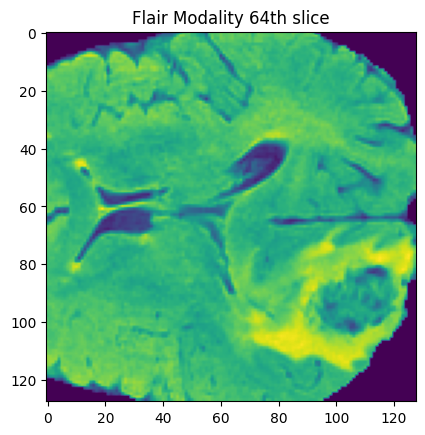

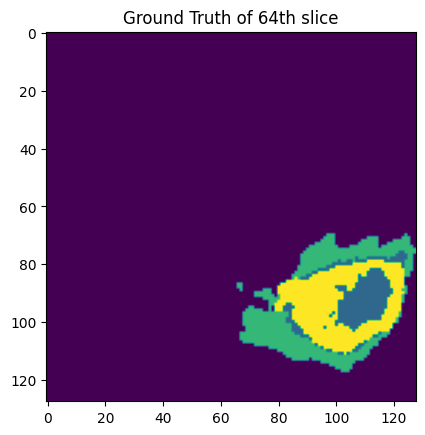

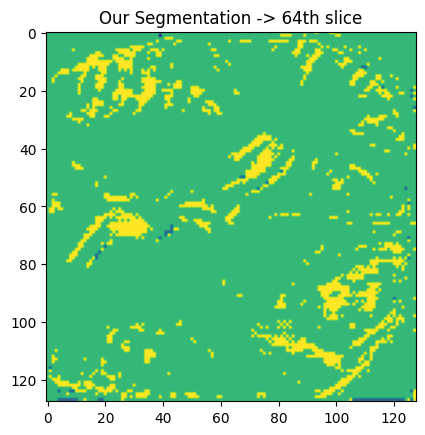

In [29]:
x = all_images[201]
print("Results on image number 201")
folder_path = path + '/' + x;
modalities = os.listdir(folder_path)
modalities.sort()
data = np.zeros((240,240,155,4))
#data = []
w = 0
for j in range(len(modalities)):
  #print(modalities[j])

  image_path = folder_path + '/' + modalities[j]
  if not(image_path.find('seg.nii') == -1):
    img = nib.load(image_path);
    image_data2 = img.get_fdata()
    image_data2 = np.asarray(image_data2)
    print("Entered ground truth")
  else:
    img = nib.load(image_path);
    image_data = img.get_fdata()
    image_data = np.asarray(image_data)
    image_data = standardize(image_data)
    data[:,:,:,w] = image_data
    print("Entered modality")
    w = w+1

print(data.shape)
print(image_data2.shape)  

reshaped_data=data[56:184,75:203,13:141,:]
reshaped_data=reshaped_data.reshape(1,128,128,128,4)
reshaped_image_data2=image_data2[56:184,75:203,13:141]


reshaped_image_data2=reshaped_image_data2.reshape(1,128,128,128)
reshaped_image_data2[reshaped_image_data2==4] = 3
#hello = reshaped_image_data2.flatten()
#y_to = keras.utils.to_categorical(y_to,num_classes=2)
print(reshaped_image_data2.shape)
#print(hello[hello==3].shape)
#print("Number of classes",np.unique(hello))
#class_weights = class_weight.compute_class_weight('balanced',np.unique(hello),hello)
#print(class_weights)

#reshaped_image_data2 = keras.utils.to_categorical(reshaped_image_data2, num_classes = 4)

print(reshaped_data.shape)
print(reshaped_image_data2.shape)
print(type(reshaped_data))

Y_hat = model.predict(x=reshaped_data)
Y_hat = np.argmax(Y_hat,axis=-1)
import matplotlib.pyplot as plt
#import matplotlib.pyplot as plt
img = reshaped_data[0,:,:,64,0]
imgplot = plt.imshow(img)
plt.title('Flair Modality 64th slice')
plt.savefig('Flair')
plt.show()

img2 = reshaped_image_data2[0,:,:,64]
imgplot2 = plt.imshow(img2)
plt.title('Ground Truth of 64th slice')
plt.savefig('Ground_Truth')
plt.show()

img3 = Y_hat[0,:,:,64]
imgplot3 = plt.imshow(img3)
plt.title('Our Segmentation -> 64th slice')
plt.savefig('Our Segmentation')
plt.show()

